# Toronto Housing Price Prediction


In this project, we are going to conduct a comperhensive analyze of the housing prices in Toronto and build a machine learning model for price prediction. This project is very helpful for the real estate market and our model can be used for both house sellers and house buyers.

Since the beginning of the COVID-19 pandemic, the real estate market has experienced many fluctuations. House prices went down during the shutdowns and went up after re-openings. All of these factors make the prediction of house prices so complicated and impossible. Proper and justified prices of properties can bring a lot of transparency and trust back to the real estate industry, which is very important for most consumers. Despite the vast amount of data, we do not have accurate measures of house prices. Therefore, this project tries to contribute to the estimate of house prices based on different features of the properties and characteristics of each neighborhood In Toronto.

Many questions such as how different areas compare to each other in terms of value, price, demographic distribution remained unanswered.

Related questions:
- Sources and means to obtain the housing dataset
- Feature engineer new predictors using different sources
- Key insights from current housing market
- ML model selection
- Hyperparameter optimization

Project’s key takeaways:
- Efficient web scraping
- Self built dataset and feature engineering
- Geographical data visualization
- Standardizing and power transforming the data
- Handling missing data
- Developing and creating ML models for house price prediction

Datasets:

- Handcrafted housing dataset (time horizon - 1 year)
- Geographical data of GTA neighbourhoods
- Neighbourhood profiles
- Geographical data of Toronto subway lines/stations


## 0. Importing useful libraries

In [ ]:
# Load dependencies
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm
import urllib.request
import time
import bs4 as bs
# from geopy.geocoders import Nominatim
import geopandas as gpd
import seaborn as sns
from scipy import stats
import re

from shapely.geometry import Point, Polygon
from tqdm import tqdm

# Set directory
import os
path = os.getcwd()
os.chdir(path)

# Set the sns style
sns.reset_defaults()
sns.set(
    rc={'figure.figsize':(15,8)}, 
    style="white"
)
sns.set_context('talk')
sns.set_style("whitegrid")

## 1. Obtaining housing data from Zolo.com



The Zolo API was selected as the resource due to it’s efficient search on currently listed and previously sold properties, albeit the data lacked granularity. The pricing data collection process included the following: 
1. A search was placed 
2. The page was converted to string format 
3. All search results represented through links were extracted to a ‘house_links’ file. This gave way to easily tracking the results by conveniently looping through the extracted list.

In [ ]:
user_agent = 'Mozilla/5.0 (Windows NT 10.0; Win64; x64; rv:98.0) Gecko/20100101 Firefox/98.0'
headers={'User-Agent':user_agent,} 

In [ ]:
total_pages = 705
links = pd.DataFrame(columns=['link'])
links_done = 0


for page in range(1,(total_pages + 1)):
    
    user_agent = 'Mozilla/5.0 (Windows NT 10.0; Win64; x64; rv:98.0) Gecko/20100101 Firefox/98.0'
    url = "https://www.zolo.ca/toronto-real-estate/sold/page-" + str(page)
    print(url)
    headers={'User-Agent':user_agent,} 

    request=urllib.request.Request(url,None,headers) #The assembled request
    data_raw = urllib.request.urlopen(request).read()
    soup = bs.BeautifulSoup(data_raw, 'html.parser')
    
    try:
        properties = soup.find('div', class_='listings-wrapper xs-flex xs-flex-wrap xs-grid sm-grid-cols-2 lg-grid-cols-3 xl-grid-cols-4 xs-gap-2 sm-gap-3 xs-mx2- sm-mx0')
        time.sleep(1)
        pat = r'href="([^"]*)"'
        info = list(set(re.findall(pat, str(properties))))

        for url in info:
            links.loc[links_done] = url
            links_done += 1
    except:
        print('not found')

links.to_csv('house_links.csv')

https://www.zolo.ca/toronto-real-estate/sold/page-1
https://www.zolo.ca/toronto-real-estate/sold/page-2
https://www.zolo.ca/toronto-real-estate/sold/page-3
https://www.zolo.ca/toronto-real-estate/sold/page-4
https://www.zolo.ca/toronto-real-estate/sold/page-5
https://www.zolo.ca/toronto-real-estate/sold/page-6
https://www.zolo.ca/toronto-real-estate/sold/page-7
https://www.zolo.ca/toronto-real-estate/sold/page-8
https://www.zolo.ca/toronto-real-estate/sold/page-9
https://www.zolo.ca/toronto-real-estate/sold/page-10
https://www.zolo.ca/toronto-real-estate/sold/page-11
https://www.zolo.ca/toronto-real-estate/sold/page-12
https://www.zolo.ca/toronto-real-estate/sold/page-13
https://www.zolo.ca/toronto-real-estate/sold/page-14
https://www.zolo.ca/toronto-real-estate/sold/page-15
https://www.zolo.ca/toronto-real-estate/sold/page-16
https://www.zolo.ca/toronto-real-estate/sold/page-17
https://www.zolo.ca/toronto-real-estate/sold/page-18
https://www.zolo.ca/toronto-real-estate/sold/page-19
ht

https://www.zolo.ca/toronto-real-estate/sold/page-155
https://www.zolo.ca/toronto-real-estate/sold/page-156
https://www.zolo.ca/toronto-real-estate/sold/page-157
https://www.zolo.ca/toronto-real-estate/sold/page-158
https://www.zolo.ca/toronto-real-estate/sold/page-159
https://www.zolo.ca/toronto-real-estate/sold/page-160
https://www.zolo.ca/toronto-real-estate/sold/page-161
https://www.zolo.ca/toronto-real-estate/sold/page-162
https://www.zolo.ca/toronto-real-estate/sold/page-163
https://www.zolo.ca/toronto-real-estate/sold/page-164
https://www.zolo.ca/toronto-real-estate/sold/page-165
https://www.zolo.ca/toronto-real-estate/sold/page-166
https://www.zolo.ca/toronto-real-estate/sold/page-167
https://www.zolo.ca/toronto-real-estate/sold/page-168
https://www.zolo.ca/toronto-real-estate/sold/page-169
https://www.zolo.ca/toronto-real-estate/sold/page-170
https://www.zolo.ca/toronto-real-estate/sold/page-171
https://www.zolo.ca/toronto-real-estate/sold/page-172
https://www.zolo.ca/toronto-

https://www.zolo.ca/toronto-real-estate/sold/page-307
https://www.zolo.ca/toronto-real-estate/sold/page-308
https://www.zolo.ca/toronto-real-estate/sold/page-309
https://www.zolo.ca/toronto-real-estate/sold/page-310
https://www.zolo.ca/toronto-real-estate/sold/page-311
https://www.zolo.ca/toronto-real-estate/sold/page-312
https://www.zolo.ca/toronto-real-estate/sold/page-313
https://www.zolo.ca/toronto-real-estate/sold/page-314
https://www.zolo.ca/toronto-real-estate/sold/page-315
https://www.zolo.ca/toronto-real-estate/sold/page-316
https://www.zolo.ca/toronto-real-estate/sold/page-317
https://www.zolo.ca/toronto-real-estate/sold/page-318
https://www.zolo.ca/toronto-real-estate/sold/page-319
https://www.zolo.ca/toronto-real-estate/sold/page-320
https://www.zolo.ca/toronto-real-estate/sold/page-321
https://www.zolo.ca/toronto-real-estate/sold/page-322
https://www.zolo.ca/toronto-real-estate/sold/page-323
https://www.zolo.ca/toronto-real-estate/sold/page-324
https://www.zolo.ca/toronto-

https://www.zolo.ca/toronto-real-estate/sold/page-459
https://www.zolo.ca/toronto-real-estate/sold/page-460
https://www.zolo.ca/toronto-real-estate/sold/page-461
https://www.zolo.ca/toronto-real-estate/sold/page-462
https://www.zolo.ca/toronto-real-estate/sold/page-463
https://www.zolo.ca/toronto-real-estate/sold/page-464
https://www.zolo.ca/toronto-real-estate/sold/page-465
https://www.zolo.ca/toronto-real-estate/sold/page-466
https://www.zolo.ca/toronto-real-estate/sold/page-467
https://www.zolo.ca/toronto-real-estate/sold/page-468
https://www.zolo.ca/toronto-real-estate/sold/page-469
https://www.zolo.ca/toronto-real-estate/sold/page-470
https://www.zolo.ca/toronto-real-estate/sold/page-471
https://www.zolo.ca/toronto-real-estate/sold/page-472
https://www.zolo.ca/toronto-real-estate/sold/page-473
https://www.zolo.ca/toronto-real-estate/sold/page-474
https://www.zolo.ca/toronto-real-estate/sold/page-475
https://www.zolo.ca/toronto-real-estate/sold/page-476
https://www.zolo.ca/toronto-

https://www.zolo.ca/toronto-real-estate/sold/page-611
https://www.zolo.ca/toronto-real-estate/sold/page-612
https://www.zolo.ca/toronto-real-estate/sold/page-613
https://www.zolo.ca/toronto-real-estate/sold/page-614
https://www.zolo.ca/toronto-real-estate/sold/page-615
https://www.zolo.ca/toronto-real-estate/sold/page-616
https://www.zolo.ca/toronto-real-estate/sold/page-617
https://www.zolo.ca/toronto-real-estate/sold/page-618
https://www.zolo.ca/toronto-real-estate/sold/page-619
https://www.zolo.ca/toronto-real-estate/sold/page-620
https://www.zolo.ca/toronto-real-estate/sold/page-621
https://www.zolo.ca/toronto-real-estate/sold/page-622
https://www.zolo.ca/toronto-real-estate/sold/page-623
https://www.zolo.ca/toronto-real-estate/sold/page-624
https://www.zolo.ca/toronto-real-estate/sold/page-625
https://www.zolo.ca/toronto-real-estate/sold/page-626
https://www.zolo.ca/toronto-real-estate/sold/page-627
https://www.zolo.ca/toronto-real-estate/sold/page-628
https://www.zolo.ca/toronto-

### Data enrichment
Looping through the generated list of links and extracting such information as:

**Title, Price, Type of property, Exact address, Bedrooms, Bathrooms, Sqft, Parking, Age, Yearly taxation, Maintenance Fees, Lattitude and Longitude.**

In [ ]:
# Prepare a table for data population
links = pd.read_csv('house_links.csv', index_col='Unnamed: 0')
data = pd.DataFrame(columns=['title','final_price', 'list_price','bedrooms','bathrooms','sqft','parking','full_link','full_address', 'postal_code', 'lat', 'long'])

In [ ]:
start_time = time.time()
skipped = []
house_length = links.shape[0]

for no in range(house_length):
    try:
        url = str(links.link[no])

        #read data, convert to 2 formats
        request=urllib.request.Request(url,None,headers) #The assembled request
        data_raw = urllib.request.urlopen(request).read()
        soup = bs.BeautifulSoup(data_raw, 'lxml')
        
        #full link
        data.loc[no,'full_link'] = url
        
        #title, bed, bath, building_type, price
        info = soup.find('div', class_='listing-photos md-flex fill-grey-bg-3 xs-relative')
        info_ = info.figure.img['alt']
        
        pat = r'For Sale: ([^,]*)'
        data.loc[no,'title'] = re.findall(pat, str(info_))[0]
        
        pat = r'(\d*)\sBed'
        data.loc[no,'bedrooms'] = re.findall(pat, str(info_))[0]
        
        pat = r'(\d*)\sBath'
        data.loc[no,'bathrooms'] = re.findall(pat, str(info_))[0]
        
        pat = r'Bath([^f]*)'
        data.loc[no,'type'] = re.findall(pat, str(info_))[0].strip()
        
        pat = r'for\s(.\d*.\d*).'
        data.loc[no,'list_price'] = re.findall(pat, str(info_))[0]
        
        #Sold on
        info = soup.find('div', class_='xs-ml2 sm-ml0 sm-mr2')
        data.loc[no,'Sold on'] = info.span.text
        
        #Size, Age Pets, Taxes, Miantenance Fees, Walk Score
        info = soup.find('section', class_='section-listing-content sm-grid sm-gap-3 xs-mb3 sm-grid-cols-2').div
        rows = info.findAll('dl')
        
        for row in rows:
            if row.dt.text == 'Type':
                data.loc[no,'type'] = row.dd.span.text
            elif row.dt.text == 'Style':
                data.loc[no,'style'] = row.dd.span.text
            elif row.dt.text == 'Size':
                data.loc[no,'sqft'] = row.dd.span.text
            elif row.dt.text == 'Age':
                data.loc[no,'age'] = row.dd.span.text
            elif row.dt.text == 'Taxes':
                data.loc[no,'tax'] = row.dd.span.text
            elif row.dt.text == 'Maintenance Fees':
                data.loc[no,'maintenance'] = row.dd.span.text
        
        #Adress
        pat = r'mapArea:."([^"]*)'
        full_address = re.findall(pat, str(soup))[0][:-6]
        #postal code
        postal_code = re.findall(pat, str(soup))[0][-6:]
        
        # lat and lon
        pat = r'propertyLat: "(\d*.\d*)"'
        lattitude = re.findall(pat, str(soup))[0]
        
        pat = r'propertyLng: "(.\d*.\d*)"'
        longitude = re.findall(pat, str(soup))[0]
        
        data.loc[no, 'lat'] = lattitude
        data.loc[no, 'long'] = longitude
        data.loc[no, 'postal_code'] = postal_code
        data.loc[no, 'full_address'] = full_address
         
        #pause and print
        time.sleep(1)
        if no % 20 == 0: 
            print(no, 'is done')
            data.to_excel('data.xlsx')
    
    except: 
        print('Problem with: ', no)
        skipped.append(no)
        continue
    
print('Skipped: ', skipped, ', Total: ', len(skipped))
print('Total time: %.2f' % (time.time() - start_time))

data.to_excel('raw_data_Zolo.xlsx')

0 is done
20 is done
40 is done
Problem with:  40
60 is done
Problem with:  65
80 is done
Problem with:  83
100 is done
Problem with:  107
120 is done
Problem with:  126
140 is done
Problem with:  147
160 is done
180 is done
200 is done
Problem with:  201
Problem with:  207
Problem with:  209
Problem with:  217
Problem with:  219
220 is done
Problem with:  224
Problem with:  236
240 is done
Problem with:  248
260 is done
280 is done
Problem with:  289
300 is done
320 is done
340 is done
Problem with:  345
Problem with:  358
360 is done
Problem with:  363
Problem with:  367
380 is done
Problem with:  398
400 is done
420 is done
440 is done
460 is done
480 is done
Problem with:  487
500 is done
Problem with:  508
Problem with:  513
Problem with:  518
520 is done
Problem with:  529
Problem with:  531
Problem with:  538
540 is done
Problem with:  550
560 is done
580 is done
600 is done
Problem with:  612
Problem with:  613
Problem with:  616
620 is done
Problem with:  627
Problem with:  63

Problem with:  4460
Problem with:  4462
Problem with:  4473
4480 is done
Problem with:  4492
4500 is done
Problem with:  4517
Problem with:  4520
Problem with:  4536
Problem with:  4540
Problem with:  4541
Problem with:  4553
4560 is done
Problem with:  4563
Problem with:  4573
4580 is done
Problem with:  4581
Problem with:  4582
Problem with:  4585
4600 is done
Problem with:  4601
Problem with:  4607
4620 is done
Problem with:  4629
Problem with:  4631
Problem with:  4635
4640 is done
Problem with:  4653
Problem with:  4656
Problem with:  4660
4680 is done
Problem with:  4683
Problem with:  4696
4700 is done
Problem with:  4702
Problem with:  4715
Problem with:  4717
4720 is done
Problem with:  4726
Problem with:  4728
4740 is done
4760 is done
4780 is done
4800 is done
Problem with:  4801
4820 is done
Problem with:  4825
Problem with:  4827
4840 is done
Problem with:  4851
4860 is done
Problem with:  4874
Problem with:  4880
4900 is done
Problem with:  4901
Problem with:  4908
4920 i

Problem with:  7355
7360 is done
Problem with:  7363
Problem with:  7370
Problem with:  7377
Problem with:  7379
7380 is done
Problem with:  7386
Problem with:  7391
Problem with:  7392
Problem with:  7396
7400 is done
Problem with:  7404
Problem with:  7406
Problem with:  7409
Problem with:  7410
Problem with:  7412
Problem with:  7416
Problem with:  7417
Problem with:  7420
Problem with:  7422
Problem with:  7424
Problem with:  7425
Problem with:  7431
7440 is done
Problem with:  7441
Problem with:  7447
Problem with:  7453
Problem with:  7460
Problem with:  7463
Problem with:  7471
Problem with:  7480
Problem with:  7484
Problem with:  7490
Problem with:  7496
7500 is done
Problem with:  7516
7520 is done
Problem with:  7526
Problem with:  7534
7540 is done
Problem with:  7544
Problem with:  7559
7560 is done
Problem with:  7564
Problem with:  7578
7580 is done
Problem with:  7582
Problem with:  7583
Problem with:  7586
Problem with:  7592
Problem with:  7599
7600 is done
Problem wi

Problem with:  9564
9580 is done
Problem with:  9587
Problem with:  9593
Problem with:  9600
Problem with:  9602
Problem with:  9603
Problem with:  9605
9620 is done
Problem with:  9633
Problem with:  9635
9640 is done
Problem with:  9648
Problem with:  9659
9660 is done
Problem with:  9669
Problem with:  9670
Problem with:  9672
Problem with:  9674
9680 is done
Problem with:  9682
Problem with:  9692
9700 is done
Problem with:  9709
Problem with:  9710
Problem with:  9714
Problem with:  9720
Problem with:  9729
Problem with:  9730
9740 is done
Problem with:  9744
Problem with:  9750
Problem with:  9752
9760 is done
Problem with:  9761
Problem with:  9770
Problem with:  9773
Problem with:  9777
9780 is done
Problem with:  9782
Problem with:  9784
Problem with:  9788
Problem with:  9791
Problem with:  9799
9800 is done
Problem with:  9802
Problem with:  9804
Problem with:  9807
Problem with:  9810
Problem with:  9817
Problem with:  9818
Problem with:  9819
9820 is done
Problem with:  98

Problem with:  11793
11800 is done
Problem with:  11804
Problem with:  11806
Problem with:  11807
Problem with:  11813
Problem with:  11814
Problem with:  11815
11820 is done
Problem with:  11822
Problem with:  11825
Problem with:  11832
Problem with:  11839
11840 is done
Problem with:  11844
Problem with:  11849
11860 is done
11880 is done
Problem with:  11891
Problem with:  11897
Problem with:  11898
11900 is done
Problem with:  11907
Problem with:  11912
Problem with:  11914
Problem with:  11917
Problem with:  11919
11920 is done
Problem with:  11921
Problem with:  11922
Problem with:  11926
Problem with:  11928
Problem with:  11937
11940 is done
Problem with:  11955
Problem with:  11957
Problem with:  11959
11960 is done
Problem with:  11970
Problem with:  11971
11980 is done
Problem with:  11983
Problem with:  11991
Problem with:  11993
Problem with:  11996
12000 is done
Problem with:  12004
Problem with:  12009
Problem with:  12017
12020 is done
Problem with:  12024
Problem with:

14000 is done
Problem with:  14006
Problem with:  14015
14020 is done
Problem with:  14027
14040 is done
Problem with:  14042
Problem with:  14047
Problem with:  14057
14060 is done
Problem with:  14061
Problem with:  14065
Problem with:  14066
Problem with:  14069
Problem with:  14075
Problem with:  14077
14080 is done
Problem with:  14085
Problem with:  14087
Problem with:  14088
14100 is done
Problem with:  14101
Problem with:  14102
Problem with:  14111
Problem with:  14117
14120 is done
Problem with:  14122
Problem with:  14134
Problem with:  14136
14140 is done
Problem with:  14145
14160 is done
Problem with:  14165
Problem with:  14170
Problem with:  14174
14180 is done
Problem with:  14193
Problem with:  14194
Problem with:  14196
14200 is done
Problem with:  14208
Problem with:  14220
Problem with:  14226
Problem with:  14238
14240 is done
Problem with:  14251
Problem with:  14254
Problem with:  14259
14260 is done
14280 is done
Problem with:  14284
Problem with:  14287
Proble

Problem with:  16372
Problem with:  16374
16380 is done
Problem with:  16395
Problem with:  16399
16400 is done
Problem with:  16403
Problem with:  16412
16420 is done
Problem with:  16421
Problem with:  16425
Problem with:  16427
16440 is done
Problem with:  16445
Problem with:  16448
Problem with:  16454
16460 is done
Problem with:  16480
16500 is done
16520 is done
Problem with:  16522
Problem with:  16531
Problem with:  16534
Problem with:  16535
16540 is done
Problem with:  16544
Problem with:  16553
16560 is done
16580 is done
Problem with:  16595
Problem with:  16596
16600 is done
Problem with:  16615
16620 is done
16640 is done
Problem with:  16650
Problem with:  16660
Problem with:  16662
16680 is done
Problem with:  16685
Problem with:  16700
Problem with:  16707
Problem with:  16710
16720 is done
16740 is done
Problem with:  16744
Problem with:  16750
Problem with:  16759
16760 is done
16780 is done
Problem with:  16786
Problem with:  16790
Problem with:  16799
16800 is done

## 2. Data Cleaning

Since the scraped data from the two websites include numeourous Nan values and outliers, a data cleaining procedure is conducted to remove the Nans and some of the outliers.

In [ ]:
# Configure Notebook
%matplotlib inline
plt.style.use('fivethirtyeight')
# sns.set_context("notebook")

In [ ]:
zolo_data = pd.read_excel('raw_data_Zolo.xlsx', index_col=0)
zolo_data.head()

,title,final_price,list_price,bedrooms,bathrooms,sqft,parking,full_link,full_address,postal_code,lat,long,type,Sold on,style,age,tax,maintenance
0,57 - 270 Timberbank Boulevard,NaN,$699888.00,3.0,3.0,1400-1599 sqft,NaN,https://www.zolo.ca/toronto-real-estate/270-ti...,"270 Timberbank boulevard, Toronto",M1W2M1,43.7969,-79.3075,Townhouse,"Mar 14, 2022",2-Storey,No Data,"$2,188 /yr",\n$529 /mo
1,26 King Edward Avenue,NaN,$929000.00,3.0,2.0,No Data,NaN,https://www.zolo.ca/toronto-real-estate/26-kin...,"26 King Edward avenue, Toronto",M4C5J6,43.6884,-79.3108,Semi-Detached,"Mar 14, 2022",2-Storey,No Data,"$3,355 /yr",NaN
2,77 Ridgecrest Drive,NaN,$1899000.00,4.0,5.0,No Data,NaN,https://www.zolo.ca/toronto-real-estate/77-rid...,"77 Ridgecrest Drive, Toronto",M1W4A3,43.7882,-79.3166,Detached,"Mar 13, 2022",2-Storey,No Data,"$5,743 /yr",NaN
3,24 Marlebon Road,NaN,$999900.00,3.0,2.0,1500-2000 sqft,NaN,https://www.zolo.ca/toronto-real-estate/24-mar...,"24 Marlebon road, Toronto",M9V3W2,43.7490,-79.6034,Detached,"Mar 14, 2022",Sidesplit 3,No Data,"$3,147 /yr",NaN
4,34 Ferris Road,NaN,$1199000.00,2.0,2.0,700-1100 sqft,NaN,https://www.zolo.ca/toronto-real-estate/34-fer...,"34 Ferris road, Toronto",M4B1G3,43.7013,-79.3082,Detached,"Mar 14, 2022",Bungalow-Raised,No Data,"$4,063 /yr",NaN


In [ ]:
zolo_data.shape

(16903, 18)

The raw dataset contains 16,903 data of the sold houses in the city of Toronto.

The first step in data cleaning is to handle the missing values. Let's see how many null values exist in the dataset.

In [ ]:
zolo_data.isnull().sum()

title            1577
final_price     16903
list_price       1591
bedrooms         1591
bathrooms        1592
sqft             1655
parking         16903
full_link           0
full_address     1976
postal_code      1976
lat              1976
long             1976
type             1591
Sold on          1655
style            1655
age              1655
tax              1655
maintenance      7820
dtype: int64

Since the data is manually scraped from the online website, lots of missing values exist in the dataset. To simplify the data exploration and analysis, we decided to drop all of the data with missing values.

In [ ]:
zolo_data.dropna(subset=['list_price'], inplace=True)
zolo_data.dropna(subset=['lat'], inplace=True)
zolo_data.dropna(subset=['long'], inplace=True)
zolo_data.dropna(subset=['Sold on'], inplace=True)
zolo_data.dropna(subset=['full_address'], inplace=True)
zolo_data['sqft'].replace({'No Data': None}, inplace=True)
zolo_data.dropna(subset=['sqft'], inplace=True)
zolo_data.drop(['maintenance'], axis=1, inplace=True)

zolo_data.isnull().sum()

title               0
final_price     10781
list_price          0
bedrooms            0
bathrooms           0
sqft                0
parking         10781
full_link           0
full_address        0
postal_code         0
lat                 0
long                0
type                0
Sold on             0
style               0
age                 0
tax                 0
dtype: int64

In [ ]:
zolo_data.shape

(10781, 17)

After dropping the missing values, we lost around 6,000 of collected data. But, we still have 10,781 data which can be useful for housing price analysis.

The next step, would be to remove the punctuations and extract the numeric values from collected stings.

In [ ]:
zolo_data['list_price'] = [int(row.replace('$', '').replace('.00','')) for row in zolo_data['list_price']]
zolo_data['sqft'] = [row.replace('sqft', '').replace('+', '').replace('<','') for row in zolo_data['sqft']]
zolo_data['sqft_min'] = [int(row.split('-')[0]) for row in zolo_data['sqft']]
zolo_data['sqft_max'] = [int(row.split('-')[-1]) for row in zolo_data['sqft']]
zolo_data['sqft_avg'] = (zolo_data['sqft_max'] + zolo_data['sqft_min'])/2
zolo_data['Sold on'] = pd.to_datetime(zolo_data['Sold on'])
zolo_data = zolo_data[zolo_data['bathrooms']<10]
zolo_data.drop(['final_price', 'parking'], axis=1, inplace=True)

There are numerous style of houses in the dataset. As the next step, we will unify the style of the houses in the dataset.

In [ ]:
zolo_data['style'].unique()

array(['2-Storey', 'Sidesplit 3', 'Bungalow-Raised', 'Apartment',
       'Multi-Level', 'Stacked Townhse', '3-Storey', '2 1/2 Storey',
       'Bungalow', 'Loft', 'Bachelor/Studio', 'Other', 'Sidesplit 4',
       'Backsplit 4', 'Backsplit 3', '1 1/2 Storey', 'Backsplit 5',
       'Bungaloft', 'Sidesplit 5'], dtype=object)

In [ ]:
zolo_data['style'] = zolo_data['style'].replace(to_replace= ['Apartment','Multi-Level', 'Bachelor/Studio'], value= 'Apt')
zolo_data['style'] = zolo_data['style'].replace(['2-Storey', 'Stacked Townhse', '3-Storey', '2 1/2 Storey', '1 1/2 Storey'], 'house')
zolo_data['style'] = zolo_data['style'].replace(['Sidesplit 3', 'Bungalow-Raised', 'Bungalow', 'Loft', 'Sidesplit 4', 'Backsplit 4', 'Backsplit 3', '1 1/2 Storey', 'Backsplit 5','Bungaloft', 'Sidesplit 5'], 'detached')

In [ ]:
zolo_data['style'].unique()

array(['house', 'detached', 'Apt', 'Other'], dtype=object)

Let's save the clean dataset for future use.

In [ ]:
zolo_data.to_csv('cleaned_zolo.csv', index=False)

A very simple graph of average square feet versus listing price, shows a very meaningful relation in our dataset.

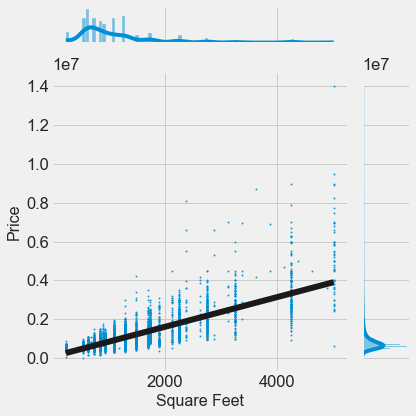

In [ ]:
ax = sns.jointplot(data=zolo_data, x="sqft_avg", y="list_price", kind="reg",
              joint_kws={'line_kws':{'color':'k'}}, scatter_kws={'s': 1})

ax.set_axis_labels('Square Feet', 'Price', fontsize=16)

ax.figure.tight_layout() 

## 3. Data Wrangling

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/My Drive/Colab Notebooks/

Mounted at /content/drive
/content/drive/My Drive/Colab Notebooks


In [ ]:
houses = pd.read_csv('cleaned_zolo.csv', index_col=0)
houses.head()

,list_price,bedrooms,bathrooms,sqft,full_link,full_address,postal_code,lat,long,type,Sold on,style,age,tax,sqft_min,sqft_max,sqft_avg
title,,,,,,,,,,,,,,,,,
57 - 270 Timberbank Boulevard,699888,3.0,3.0,1400-1599,https://www.zolo.ca/toronto-real-estate/270-ti...,"270 Timberbank boulevard, Toronto",M1W2M1,43.7969,-79.3075,Townhouse,2022-03-14,house,No Data,"$2,188 /yr",1400,1599,1499.5
24 Marlebon Road,999900,3.0,2.0,1500-2000,https://www.zolo.ca/toronto-real-estate/24-mar...,"24 Marlebon road, Toronto",M9V3W2,43.7490,-79.6034,Detached,2022-03-14,detached,No Data,"$3,147 /yr",1500,2000,1750.0
34 Ferris Road,1199000,2.0,2.0,700-1100,https://www.zolo.ca/toronto-real-estate/34-fer...,"34 Ferris road, Toronto",M4B1G3,43.7013,-79.3082,Detached,2022-03-14,detached,No Data,"$4,063 /yr",700,1100,900.0
Ph37 - 300 Mill Road,949000,3.0,3.0,1800-1999,https://www.zolo.ca/toronto-real-estate/300-mi...,"300 Mill road, Toronto",M9C4W7,43.6387,-79.5843,Condo,2022-03-14,house,No Data,"$3,080 /yr",1800,1999,1899.5
1611 - 31 Tippett Road,899000,2.0,2.0,800-899,https://www.zolo.ca/toronto-real-estate/31-tip...,"31 Tippett road, Toronto M",3H 0C8,43.7335,-79.4461,Condo,2022-03-14,Apt,No Data,No Data,800,899,849.5


To make sure that there is no duplicate values in our data, we are droping duplicate based on the `full_link` attribute of our dataset.

In [ ]:
houses.drop_duplicates(subset=['full_link'], inplace=True)

### Adding income, area name and area code to the housiung data
As the next step of data wrangling, we are going to merge the neighbourhood datasets with our housing data.

The ultimate goal is to assign each house data with the mean income of their corresponding neighbourhood.

The first dataset that we are using is the `neighbourhood profiles`. This dataset is collected in 2016 and contains very detailed information about education, ethnicity, immigration/citizenship, income, population, etc. 

Only income data and area codes/names are required.

In [ ]:
# Get Toronto neighbourhood data and extract district codes with their average incomes
t_data = pd.read_csv('Dataset/opendata_neighbourhoods/neighbourhood-profiles-2016-csv.csv')

t_income = t_data[(t_data.Characteristic == 'Neighbourhood Number') | (t_data.Characteristic == 'Total income: Average amount ($)')]
t_income = t_income.T.reset_index()

t_income.columns = ['area', 'area_code', 'average_income']
t_income = t_income.iloc[6:,:]
print(t_income.head())
print('-' * 60)

# convert income and area into integers
print(t_income.info())
print('-' * 60)
t_income['average_income'] = t_income['average_income'].apply(lambda a: a.replace(',','')).astype('int64')
t_income['area_code'] = t_income['area_code'].astype('int64')
print(t_income.info())
print('-' * 60)

# Calculate incoem mean
mean_t_income = t_income['average_income'].mean()
print('GTA mean income: ',mean_t_income)


                            area area_code average_income
6                Agincourt North       129         30,414
7   Agincourt South-Malvern West       128         31,825
8                      Alderwood        20         47,709
9                          Annex        95        112,766
10             Banbury-Don Mills        42         67,757
------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 140 entries, 6 to 145
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   area            140 non-null    object
 1   area_code       140 non-null    object
 2   average_income  140 non-null    object
dtypes: object(3)
memory usage: 3.4+ KB
None
------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 140 entries, 6 to 145
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype 
---  ------  

In order to assign the neigbourhood data on house data, we need to know within which area the houses are. To identify this, we are using the lat and long of houses data to create a geometry object for each house. It should be noted that EPSG:4269 is used as crs in this project.


In [ ]:
# Use gpd.GeoDataFrame() to create a GeoDataFrame from houses and assign the new GeoDataFrame to a new variable called houses_gdf.
houses_gdf = gpd.GeoDataFrame(houses, geometry=gpd.points_from_xy(houses.long, houses.lat))
houses_gdf.head()

,list_price,bedrooms,bathrooms,sqft,full_link,full_address,postal_code,lat,long,type,Sold on,style,age,tax,sqft_min,sqft_max,sqft_avg,geometry
title,,,,,,,,,,,,,,,,,,
57 - 270 Timberbank Boulevard,699888,3.0,3.0,1400-1599,https://www.zolo.ca/toronto-real-estate/270-ti...,"270 Timberbank boulevard, Toronto",M1W2M1,43.7969,-79.3075,Townhouse,2022-03-14,house,No Data,"$2,188 /yr",1400,1599,1499.5,POINT (-79.30750 43.79690)
24 Marlebon Road,999900,3.0,2.0,1500-2000,https://www.zolo.ca/toronto-real-estate/24-mar...,"24 Marlebon road, Toronto",M9V3W2,43.7490,-79.6034,Detached,2022-03-14,detached,No Data,"$3,147 /yr",1500,2000,1750.0,POINT (-79.60340 43.74900)
34 Ferris Road,1199000,2.0,2.0,700-1100,https://www.zolo.ca/toronto-real-estate/34-fer...,"34 Ferris road, Toronto",M4B1G3,43.7013,-79.3082,Detached,2022-03-14,detached,No Data,"$4,063 /yr",700,1100,900.0,POINT (-79.30820 43.70130)
Ph37 - 300 Mill Road,949000,3.0,3.0,1800-1999,https://www.zolo.ca/toronto-real-estate/300-mi...,"300 Mill road, Toronto",M9C4W7,43.6387,-79.5843,Condo,2022-03-14,house,No Data,"$3,080 /yr",1800,1999,1899.5,POINT (-79.58430 43.63870)
1611 - 31 Tippett Road,899000,2.0,2.0,800-899,https://www.zolo.ca/toronto-real-estate/31-tip...,"31 Tippett road, Toronto M",3H 0C8,43.7335,-79.4461,Condo,2022-03-14,Apt,No Data,No Data,800,899,849.5,POINT (-79.44610 43.73350)


Then, we downloaded the neighbourhood locations and shapes from Open Data Portal and converting them from their original Shapefile format to a more manageable one.

Using EPSG:4269 in this case we’ll ensure that the coordinates align for both neighbourhoods and houses.


In [ ]:
#Obtaining neighbourhood locations and shapes from Open Data Portal and converting them from their original Shapefile format to a more manageable one.
#Using EPSG:4269 (Lat, Long format) in this case we’ll ensure that the coordinates align for both areas and properties.
t_geodata = gpd.read_file('Dataset/opendata_neighbourhoods/Neighbourhoods.shp')

# rename columns
t_geodata_columns = pd.read_csv('Dataset/opendata_neighbourhoods/Neighbourhoods_fields.csv')
t_geodata.columns = t_geodata_columns.name.values

# Convert data to lat, long type
t_geodata['geometry'] = t_geodata['geometry'].to_crs({'init': 'EPSG:4326'})
t_geodata.head()

,_id,AREA_ID,AREA_ATTR_ID,PARENT_AREA_ID,AREA_SHORT_CODE,AREA_LONG_CODE,AREA_NAME,AREA_DESC,X,Y,LONGITUDE,LATITUDE,OBJECTID,Shape__Area,Shape__Length,geometry
0,141,25886861,25926662,49885,94,94,Wychwood (94),Wychwood (94),None,None,-79.425515,43.676919,16491505,3.217960e+06,7515.779658,"POLYGON ((-79.43592 43.68015, -79.43492 43.680..."
1,142,25886820,25926663,49885,100,100,Yonge-Eglinton (100),Yonge-Eglinton (100),None,None,-79.403590,43.704689,16491521,3.160334e+06,7872.021074,"POLYGON ((-79.41096 43.70408, -79.40962 43.704..."
2,143,25886834,25926664,49885,97,97,Yonge-St.Clair (97),Yonge-St.Clair (97),None,None,-79.397871,43.687859,16491537,2.222464e+06,8130.411276,"POLYGON ((-79.39119 43.68108, -79.39141 43.680..."
3,144,25886593,25926665,49885,27,27,York University Heights (27),York University Heights (27),None,None,-79.488883,43.765736,16491553,2.541821e+07,25632.335242,"POLYGON ((-79.50529 43.75987, -79.50488 43.759..."
4,145,25886688,25926666,49885,31,31,Yorkdale-Glen Park (31),Yorkdale-Glen Park (31),None,None,-79.457108,43.714672,16491569,1.156669e+07,13953.408098,"POLYGON ((-79.43969 43.70561, -79.44011 43.705..."


The data of neighbourhoods shapes and their corresponding incomes are merged as `all_t_data`.

In [ ]:
# Merge districts geodata and Toronto income

all_t_data = t_geodata.merge(t_income, left_on='AREA_SHORT_CODE', right_on='area_code')
useless_columns_all_t_data = ['_id', 'AREA_ID', 'AREA_ATTR_ID', 'PARENT_AREA_ID', 'AREA_SHORT_CODE', 'AREA_LONG_CODE',
                             'AREA_NAME', 'AREA_DESC', 'X', 'Y','LONGITUDE','LATITUDE']
all_t_data.drop(useless_columns_all_t_data, axis=1, inplace=True)
all_t_data.to_csv('all_t_data.csv')
all_t_data.head()

,OBJECTID,Shape__Area,Shape__Length,geometry,area,area_code,average_income
0,16491505,3.217960e+06,7515.779658,"POLYGON ((-79.43592 43.68015, -79.43492 43.680...",Wychwood,94,54460
1,16491521,3.160334e+06,7872.021074,"POLYGON ((-79.41096 43.70408, -79.40962 43.704...",Yonge-Eglinton,100,89330
2,16491537,2.222464e+06,8130.411276,"POLYGON ((-79.39119 43.68108, -79.39141 43.680...",Yonge-St.Clair,97,114174
3,16491553,2.541821e+07,25632.335242,"POLYGON ((-79.50529 43.75987, -79.50488 43.759...",York University Heights,27,29958
4,16491569,1.156669e+07,13953.408098,"POLYGON ((-79.43969 43.70561, -79.44011 43.705...",Yorkdale-Glen Park,31,38527


Each house in the dataset requires a mean income and area name assigned to it. To achieve this each house is crosschecked by being projected on the map.

Some areas that do not belong anywhere also lie beyond our target map. After careful considerations, We’ve decided that these areas are outside of the project scope and could be safely removed.

In [ ]:
from shapely.geometry import Point, Polygon
from tqdm import tqdm

def find_district(point, df):
    '''
    Returns District name, Area code, and District average income
    '''

    in_shape = []
    for sh in df.geometry:
        within = point.within(sh)
        in_shape.append(within)
    return df.loc[in_shape.index(True), 'area'], df.loc[in_shape.index(True), 'area_code'], df.loc[in_shape.index(True), 'average_income']


houses['mean_district_income'] = 0
houses['district_code'] = 0

not_assigned = []
for row, value in tqdm(houses.iterrows()):
    try:
        result = find_district(Point(houses.loc[row, 'long'], houses.loc[row, 'lat']), all_t_data)
        houses.loc[row, 'city_district'] = result[0]
        houses.loc[row, 'mean_district_income'] = result[2]
        houses.loc[row, 'district_code'] = result[1]
        time.sleep(0.1)
    except:
        not_assigned.append(row)
        
# Not assigned houses
print(not_assigned)

10671it [21:24,  8.31it/s]

['1202 - 1275 Markham Road', '317 - 1050 Main Street East Street', '1202 - 1275 Markham Road', '17 Kenwood Drive']


In [ ]:
houses.to_csv('houses_with_income.csv')

## 4. Exploratory Data Analysis

Let's start the data examination from `Distribution of Income in GTA` and `Distribution of Housing Price in GTA`.

In [ ]:
houses_income = pd.read_csv('houses_with_income.csv', index_col='title')
all_t_data = pd.read_csv('all_t_data.csv', index_col= 'Unnamed: 0')

In [ ]:
houses.columns

Index(['list_price', 'bedrooms', 'bathrooms', 'sqft', 'full_link',
       'full_address', 'postal_code', 'lat', 'long', 'type', 'Sold on',
       'style', 'age', 'tax', 'sqft_min', 'sqft_max', 'sqft_avg', 'geometry',
       'mean_district_income', 'district_code', 'city_district'],
      dtype='object')

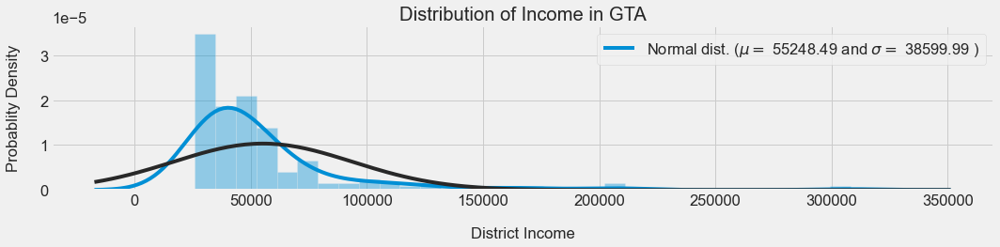

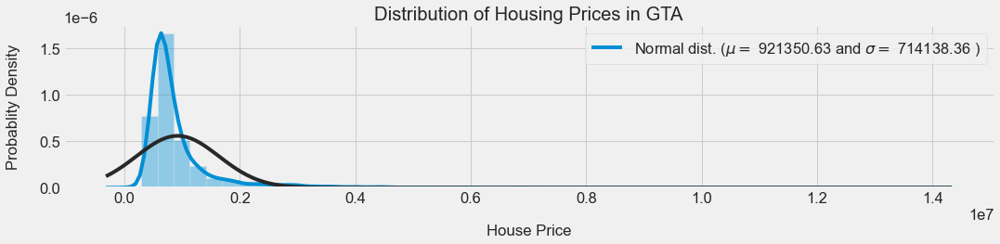

In [ ]:
plt.figure(1, figsize=[16,3])

plt.subplots_adjust(hspace=0.4)
ax = sns.distplot(all_t_data['average_income'], fit=stats.norm)
plt.xlabel('District Income', labelpad=20)
plt.ylabel('Probablity Density', labelpad=20)
plt.title('Distribution of Income in GTA')
(mu, sigma) = stats.norm.fit(all_t_data['average_income'])
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')

plt.figure(2, figsize=[16,3])

ax = sns.distplot(houses['list_price'], fit=stats.norm)
plt.xlabel('House Price', labelpad=20)
plt.ylabel('Probablity Density', labelpad=20)
plt.title('Distribution of Housing Prices in GTA')
(mu, sigma) = stats.norm.fit(houses['list_price'])
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')

plt.show()

In the above figures we can clearly see our Prices and Income data are very positively skewed which probably affect results on the map. (The data has many outliers; therefore, many colours wouldn't even be shown on the map). We decided to explore the **scipy.stats** package in order to find an appropriate power transformer. 

Log transform is an excellent method to convert positively skewed data into normal, but here I mainly focused on automatic power conversion named Boxcox.

> A Box Cox transformation is a way to transform non-normal dependent variables into a normal shape. Normality is an important assumption for many statistical techniques; if your data isn’t normal, applying a Box-Cox means that you are able to run a broader number of tests.
The Box Cox transformation is named after statisticians George Box and Sir David Roxbee Cox who collaborated on a 1964 paper and developed the technique.



<center>The one-parameter Box–Cox transformations are defined as:</center>

<img src="img/boxcox.svg" alt="Drawing"/>

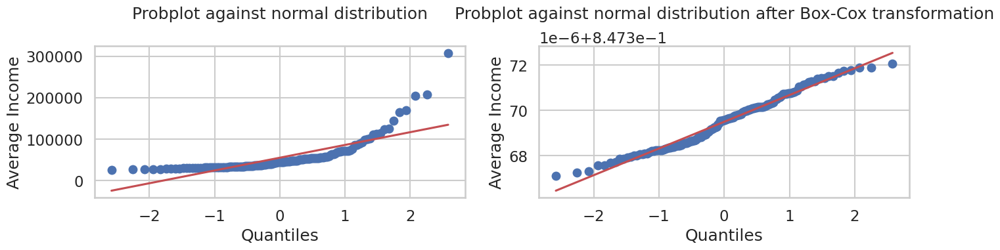

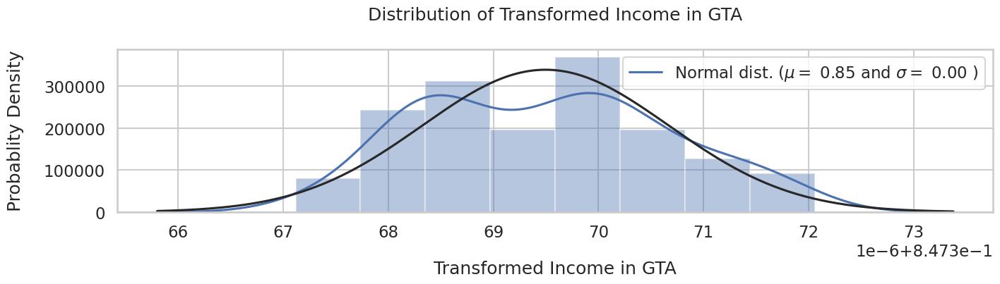

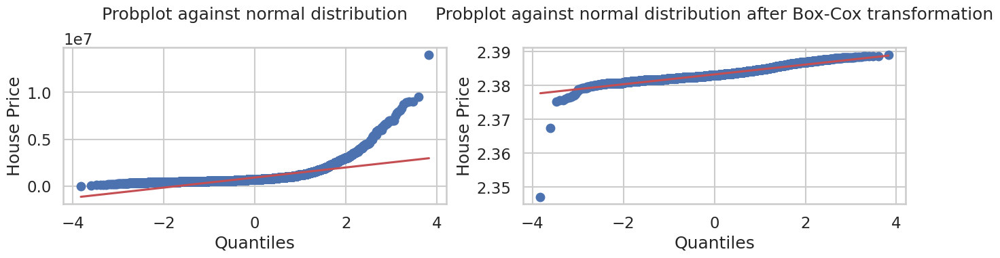

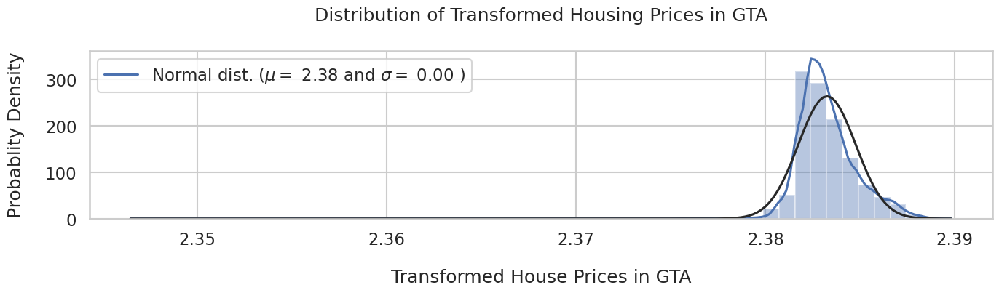

In [ ]:
plt.figure(1, figsize=[16,3])

ax1=plt.subplot(1,2,1)
x = all_t_data['average_income']
stats.probplot(x, dist=stats.norm, plot=ax1)
ax1.set_xlabel('Quantiles')
ax1.set_ylabel('Average Income')
ax1.set_title('Probplot against normal distribution', pad=30)


ax2=plt.subplot(1,2,2)
boxcox_lambda = stats.boxcox_normmax(x, brack=(-1.9, 2.0),  method='mle')
transformed_array = stats.boxcox(x, boxcox_lambda)
stats.probplot(transformed_array, dist=stats.norm , plot=ax2)
ax2.set_xlabel('Quantiles')
ax2.set_ylabel('Average Income')
ax2.set_title('Probplot against normal distribution after Box-Cox transformation', pad=30)

# transform data
all_t_data['average_income_transformed'] = transformed_array
# To transform back
# np.exp(np.log(boxcox_lambda*transformed_array+1)/boxcox_lambda)

plt.figure(2, figsize=[16,3])
sns.distplot(all_t_data['average_income_transformed'], fit=stats.norm)
plt.title('Distribution of Transformed Income in GTA', pad=30)
plt.xlabel('Transformed Income in GTA', labelpad=20)
plt.ylabel('Probablity Density', labelpad=20)
(mu, sigma) = stats.norm.fit(all_t_data['average_income_transformed'])
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')

plt.figure(3, figsize=[16,3])

ax3=plt.subplot(1,2,1)
x = houses['list_price']
stats.probplot(x, dist=stats.norm, plot=ax3)
ax3.set_xlabel('Quantiles')
ax3.set_ylabel('House Price')
ax3.set_title('Probplot against normal distribution', pad=30)


ax4=plt.subplot(1,2,2)
boxcox_lambda = stats.boxcox_normmax(x, brack=(-1.9, 2.0),  method='mle')
transformed_array = stats.boxcox(x, boxcox_lambda)
stats.probplot(transformed_array, dist=stats.norm , plot=ax4)
ax4.set_xlabel('Quantiles')
ax4.set_ylabel('House Price')
ax4.set_title('Probplot against normal distribution after Box-Cox transformation', pad=30)

houses['final_price_transformed'] = transformed_array

plt.figure(4, figsize=[16,3])
sns.distplot(houses['final_price_transformed'], fit=stats.norm)
plt.xlabel('Transformed House Prices in GTA', labelpad=20)
plt.ylabel('Probablity Density', labelpad=20)
plt.title('Distribution of Transformed Housing Prices in GTA', pad=30)
(mu, sigma) = stats.norm.fit(houses['final_price_transformed'])
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')


all_t_data['average_income_log']= np.log(all_t_data['average_income'])
houses['final_price_log']= np.log(houses['list_price'])

plt.show()

In [ ]:
houses.to_csv('houses_with_income.csv')

### Ploting house data on Toronto map

With the normalized and transformed data, we’re ready to plot them and visually analyze how they relate to each other. To do so, we are going to use the `Bokeh` library.



The Bokeh library provided high-resolution interactive geomaps thereby making it the ideal tool to validate and visualize our geodata.

> Bokeh is an interactive visualization library that targets modern web browsers for presentation. Its goal is to provide elegant, concise construction of versatile graphics, and to extend this capability with high-performance interactivity over very large or streaming datasets. Bokeh can help anyone who would like to quickly and easily create interactive plots, dashboards, and data applications.



In [ ]:
all_t_data['geometry'] = gpd.GeoSeries.from_wkt(all_t_data['geometry'])
all_t_data = gpd.GeoDataFrame(all_t_data, geometry=all_t_data['geometry'])

In [ ]:
import json
from bokeh.io import output_notebook, show, output_file
from bokeh.plotting import figure
from bokeh.palettes import brewer
from bokeh.models import GeoJSONDataSource, LinearColorMapper, ColorBar, Label, HoverTool, AjaxDataSource
from bokeh.resources import INLINE

#Read data to json.
t_geodata_json = json.loads(all_t_data.to_json())

#Convert to String like object.
json_data = json.dumps(t_geodata_json)


#Input GeoJSON source that contains features for plotting.
geosource = GeoJSONDataSource(geojson = json_data)

#Add hover tool
hover = HoverTool(tooltips = [ ('District','@area'),('Average Income', '@average_income')])


p = figure(title = 'GTA Neighbourhood Income', plot_height = 600 , plot_width = 950, tools = [hover])
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None


# Add patch renderer to figure. 
palette = brewer['Spectral'][11] #[::-1]
color_mapper = LinearColorMapper(palette = palette,
                                 low = all_t_data['average_income_transformed'].min(),
                                 high = all_t_data['average_income_transformed'].max())

p.patches('xs','ys', source = geosource,
          line_color = 'white', line_width = 0.25, fill_alpha = 1,
         fill_color = {'field' :'average_income_transformed', 'transform' : color_mapper})


#Display figure in Jupyter Notebook.
output_notebook(INLINE)
#Display figure.
show(p)

### Augmenting Toronto's subway lines and station to the map

As the next step, let's augment the subway lines and stations to our housing price data.

In [ ]:
%cd /content/drive/My Drive/TTC_SubwayLines_20120119
slines_geodata = gpd.read_file('subwayLines.shp')
%cd /content/drive/My Drive/TTC_SubwayStns_20120119
sstations_geodata = gpd.read_file('subwayStations.shp')

/content/drive/My Drive/TTC_SubwayLines_20120119
/content/drive/My Drive/TTC_SubwayStns_20120119


In [ ]:
# load TTC stations and lines
#slines_geodata = gpd.read_file('Dataset/TTC_SubwayLines_20120119/subwayLines.shp')
#sstations_geodata = gpd.read_file('Dataset/TTC_SubwayStns_20120119/subwayStations.shp')

slines_geodata['colors'] = ['limegreen', 'plum', 'dodgerblue', 'gold']

for dataset in [slines_geodata, sstations_geodata]:
    dataset['geometry'] = dataset['geometry'].to_crs({'init': 'EPSG:4269'})

Now, let's plot both subwayline and stations along with housing data.

In [ ]:
from bokeh.models.glyphs import MultiLine
from bokeh.models import Cross,NumeralTickFormatter

# Input GeoJSON source that contains features for plotting.
geosource = GeoJSONDataSource(geojson = all_t_data.to_json())
slines_source = GeoJSONDataSource(geojson = slines_geodata.to_json())
sstation_source = GeoJSONDataSource(geojson = sstations_geodata.to_json())

p = figure(title = 'GTA housing prices projected on average district wages', plot_height = 680 , plot_width = 950,
          active_scroll='wheel_zoom')
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None


# Add patch renderer to figure - Areas and Average Income. 
palette_1 = brewer['RdBu'][11]
color_mapper_1 = LinearColorMapper(palette = palette_1,
                                 low = all_t_data['average_income_log'].min(),
                                 high = all_t_data['average_income_log'].max())

p.patches('xs','ys', source = geosource,
          line_color = 'white', line_width = 0.25, fill_alpha = 0.7,
         fill_color = {'field' :'average_income_log', 'transform' : color_mapper_1})

#Add subway lines
p.multi_line('xs', 'ys', source=slines_source, color='colors', line_width=2.5)


#Define custom tick labels for color bar.
tick_labels = {'10': '22K','10.5':'35K','11':'60K','11.5':'100k', '12':'162K', '12.5':'268k'}

#Create color bar 1. 
color_bar_1 = ColorBar(color_mapper=color_mapper_1, label_standoff=8,width = 500, height = 15,
border_line_color=None,location = (0,0), orientation = 'horizontal', major_label_overrides = tick_labels, title='Income')

#Specify figure layout.
p.add_layout(color_bar_1, 'below')


# Add houses to the map
palette = brewer['Spectral'][11]
color_mapper = LinearColorMapper(palette = palette,
                                 low = houses_income['final_price_log'].min(),
                                 high = houses_income['final_price_log'].max())

geosource_2 = AjaxDataSource(houses_income)
p1 = p.circle('long', 'lat', alpha=0.3, radius=0.0006, color={'field': 'final_price_log', 'transform': color_mapper}, source=geosource_2)



#Define custom tick labels for color bar.
tick_labels = {'10': '22K', '11':'60K', '12': '160K','13':'440K','14':'1,200K','15':'3,270k', '16':'8,890K'}

#Create color bar 2. 
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 15,
border_line_color=None,location = (0,0), orientation = 'horizontal', major_label_overrides = tick_labels, title='House Price')


# Add hover tool
hover = HoverTool(renderers=[p1],
                     tooltips =[('District','@city_district'),
                               ('District Income', '$ @mean_district_income{0,0}'), 
                               ('Price','$ @list_price{0,0}'),
                               ('Type', '@type')])
p.add_tools(hover)

#Specify figure layout.
p.add_layout(color_bar, 'below')

# Add subway stations
p.circle('x', 'y', source=sstation_source, radius=0.001, color="white", line_color='black', line_width=0.3)

#Display figure in Jupyter Notebook.
output_notebook()

#Display figure.
show(p)

After plotting housing data on the map, we can see two levels:

- Bottom level represents the districts and average annual wages in the areas.
- Medium level represents the Toronto subway lines and stations
- Top above represents housing prices

Based on the plot there are a few important observations to be made:

- Average income and house price correlate with each other
- A majority of the Condo apartments (mostly green), are concentrated downtown and across subway lines towards North York (prices ranges from 500k to 700k).
- A majority of the areas in yellow/red are restricted to detached houses, for which the price varies between 800k and 1,500k.
- Logically, a disproportionately high number of condos were sold in the downtown area than any other
- A majority of low-income areas like Scarborough have Co-op Apartments and Condos within price range of 200k - 400k range
- Top three most-expensive areas includes: 
    - York Mills
    - Rosedale-Moore Park
    - Forest Hill South


## 5. Data Pre-processing
Having access to the `Sold on` and `tax` data can be a useful feature in analysis of housing prices. 

In our dataset, the `tax` column contains the yearly tax of each houses. To be useful, this column needs to be organized.

The `Sold_on` column can also be very useful in our prediction. In order to make the datetime column useable, we are going to extract the month from the `Sold_on` and add it to our dataset as `month_sold` column.

In [ ]:
houses_income = pd.read_csv('houses_with_income.csv', index_col='title')
houses_income.head()

,list_price,bedrooms,bathrooms,sqft,full_link,full_address,postal_code,lat,long,type,...,tax,sqft_min,sqft_max,sqft_avg,geometry,mean_district_income,district_code,city_district,final_price_transformed,final_price_log
title,,,,,,,,,,,,,,,,,,,,,
57 - 270 Timberbank Boulevard,699888,3.0,3.0,1400-1599,https://www.zolo.ca/toronto-real-estate/270-ti...,"270 Timberbank boulevard, Toronto",M1W2M1,43.7969,-79.3075,Townhouse,...,"$2,188 /yr",1400,1599,1499.5,POINT (-79.3075 43.7969),31826,117,L'Amoreaux,2.382954,13.458676
24 Marlebon Road,999900,3.0,2.0,1500-2000,https://www.zolo.ca/toronto-real-estate/24-mar...,"24 Marlebon road, Toronto",M9V3W2,43.7490,-79.6034,Detached,...,"$3,147 /yr",1500,2000,1750.0,POINT (-79.6034 43.749),31771,1,West Humber-Clairville,2.384146,13.815411
34 Ferris Road,1199000,2.0,2.0,700-1100,https://www.zolo.ca/toronto-real-estate/34-fer...,"34 Ferris road, Toronto",M4B1G3,43.7013,-79.3082,Detached,...,"$4,063 /yr",700,1100,900.0,POINT (-79.3082 43.7013),43907,54,O'Connor-Parkview,2.384688,13.996998
Ph37 - 300 Mill Road,949000,3.0,3.0,1800-1999,https://www.zolo.ca/toronto-real-estate/300-mi...,"300 Mill road, Toronto",M9C4W7,43.6387,-79.5843,Condo,...,"$3,080 /yr",1800,1999,1899.5,POINT (-79.5843 43.6387),62378,12,Markland Wood,2.383983,13.763164
1611 - 31 Tippett Road,899000,2.0,2.0,800-899,https://www.zolo.ca/toronto-real-estate/31-tip...,"31 Tippett road, Toronto M",3H 0C8,43.7335,-79.4461,Condo,...,No Data,800,899,849.5,POINT (-79.4461 43.7335),51181,33,Clanton Park,2.383809,13.709038


In [ ]:
# extract month_sold
houses_income['month_sold'] = pd.to_datetime(houses_income['Sold on']).dt.month

We found out that there are numerous 'No Data' entries in the tax column. At this stage, we replaced all of them with zeros.

Let's see how all these columns affect the house price. First of all the categorical columns need to be one-hot-encoded.

In [ ]:
# clean tax colmun
houses_income['tax'] = houses_income['tax'].str.strip().str.replace('$','').str.replace(',','').str.replace(' /yr','').str.replace('No Data', '0').astype(int)

As you can see, there are numerous 'No Data' entries in the tax column. At this stage, we replaced all of them with zeros.

Let's see how all these columns affect the house price. First of all the categorical columns need to be one-hot-encoded.

In [ ]:
needed_columns = ['list_price', 'bedrooms', 'bathrooms', 'month_sold', 'style',
                  'tax', 'sqft_avg', 'mean_district_income']

houses_dummies = pd.get_dummies(houses_income[needed_columns])
houses_dummies.head()

,list_price,bedrooms,bathrooms,month_sold,tax,sqft_avg,mean_district_income,style_Apt,style_Other,style_detached,style_house
title,,,,,,,,,,,
57 - 270 Timberbank Boulevard,699888,3.0,3.0,3,2188,1499.5,31826,0,0,0,1
24 Marlebon Road,999900,3.0,2.0,3,3147,1750.0,31771,0,0,1,0
34 Ferris Road,1199000,2.0,2.0,3,4063,900.0,43907,0,0,1,0
Ph37 - 300 Mill Road,949000,3.0,3.0,3,3080,1899.5,62378,0,0,0,1
1611 - 31 Tippett Road,899000,2.0,2.0,3,0,849.5,51181,1,0,0,0


At this stage, we will use **Pandas Profiling**.

The pandas df.describe() function is great but a little basic for serious exploratory data analysis. 
pandas_profiling extends the pandas DataFrame with df.profile_report() for quick data analysis.

For each column the following statistics - if relevant for the column type - are presented in an interactive HTML report:
- **Essentials**: type, unique values, missing values
- **Quantile** statistics like minimum value, Q1, median, Q3, maximum, range, interquartile range
- **Descriptive** statistics like mean, mode, standard deviation, sum, median absolute deviation, coefficient of variation, kurtosis, skewness
- **Most frequent values**
- **Histogram**
- **Correlations** highlighting of highly correlated variables, Spearman, Pearson and Kendall matrices
- **Missing values** matrix, count, heatmap and dendrogram of missing values


In [ ]:
# !pip install pandas-profiling

In [ ]:
import pandas_profiling
houses_income.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

To determine which features are most significant for our analysis and which values require imputing, we’ll need to construct a feature importance matrix and plot it with **Matplotlib**.

There are many techniques to assess feature importance, here we’ll employ a simple one: **Tree Regressor**.



In [ ]:
features = houses_dummies.drop('list_price', axis=1)
labels = houses_dummies[['list_price']]

In [ ]:
features.isnull().sum()

bedrooms                0
bathrooms               0
month_sold              0
tax                     0
sqft_avg                0
mean_district_income    0
style_Apt               0
style_Other             0
style_detached          0
style_house             0
dtype: int64

In [ ]:
labels.isnull().sum()

list_price    0
dtype: int64

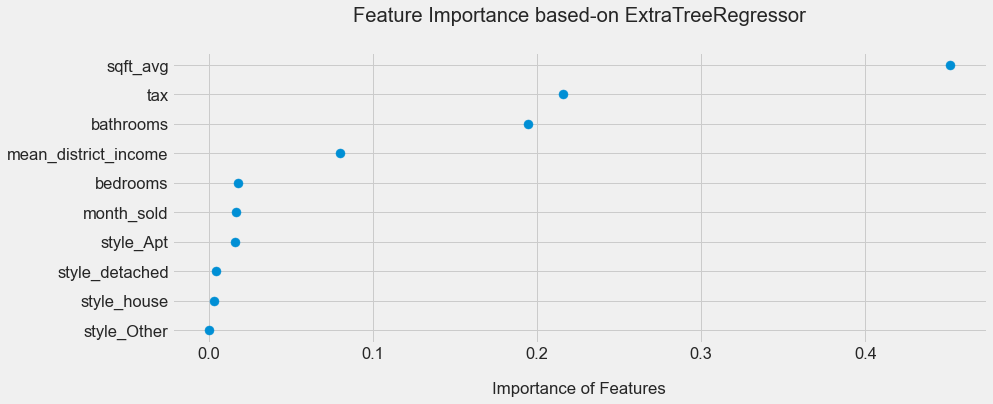

In [ ]:
from sklearn.ensemble import ExtraTreesRegressor

# sns.set_style("whitegrid")
plt.figure(figsize=[13,5])
model = ExtraTreesRegressor(n_estimators=10)
model.fit(features, labels)

# display the relative importance of each attribute
sorted_feature_importance = sorted(zip(model.feature_importances_, features.columns))

x = [a[0] for a in sorted_feature_importance]
y = [a[1] for a in sorted_feature_importance]

plt.scatter(x,y)
plt.xlabel('Importance of Features', labelpad=20)
plt.title('Feature Importance based-on ExtraTreeRegressor', pad=30)
plt.show()

It appears that one of the most effective feature is **sqft_avg**. 

The other most important feature is **tax**. Since we have some missing values in tax, which are replaced with 0 right now, it is important to make some precise estimations on this features.

So, let's use KNNImputer to estimate the missing values of taxes based on K nearest neighbor houses.

In [ ]:
from sklearn.impute import KNNImputer

# load original house_income data
houses_income = pd.read_csv('houses_with_income.csv', index_col='title')

# extract months of sold
houses_income['month_sold'] = pd.to_datetime(houses_income['Sold on']).dt.month
# clean the tax column
houses_income['tax'] = houses_income['tax'].str.strip().str.replace('$','').str.replace(',','').str.replace(' /yr','')
# replace "No Data" with Nan
for index, row in houses_income.iterrows():
    if row['tax'] == 'No Data':
        houses_income.loc[index, 'tax'] = np.nan
    else:
        try:
            houses_income.loc[index, 'tax'] = float(row['tax'])
        except:
            print(row['tax'])

dummies_columns = ['list_price', 'bedrooms', 'bathrooms', 'month_sold', 'style', 'sqft_avg', 'mean_district_income']

houses_dummies = pd.get_dummies(houses_income[dummies_columns])
houses_dummies['tax'] = houses_income['tax']

imputer = KNNImputer(n_neighbors=2, weights="uniform")
houses_dummies['tax'] = imputer.fit_transform(houses_dummies)[:,-1]

print(houses_dummies.isnull().sum())
houses_dummies.head()

list_price              0
bedrooms                0
bathrooms               0
month_sold              0
sqft_avg                0
mean_district_income    0
style_Apt               0
style_Other             0
style_detached          0
style_house             0
tax                     0
dtype: int64


,list_price,bedrooms,bathrooms,month_sold,sqft_avg,mean_district_income,style_Apt,style_Other,style_detached,style_house,tax
title,,,,,,,,,,,
57 - 270 Timberbank Boulevard,699888,3.0,3.0,3,1499.5,31826,0,0,0,1,2188.0
24 Marlebon Road,999900,3.0,2.0,3,1750.0,31771,0,0,1,0,3147.0
34 Ferris Road,1199000,2.0,2.0,3,900.0,43907,0,0,1,0,4063.0
Ph37 - 300 Mill Road,949000,3.0,3.0,3,1899.5,62378,0,0,0,1,3080.0
1611 - 31 Tippett Road,899000,2.0,2.0,3,849.5,51181,1,0,0,0,3076.5


Before testing out the importance of tax on the price, let's examine the distribution of bedrooms in our dataset.

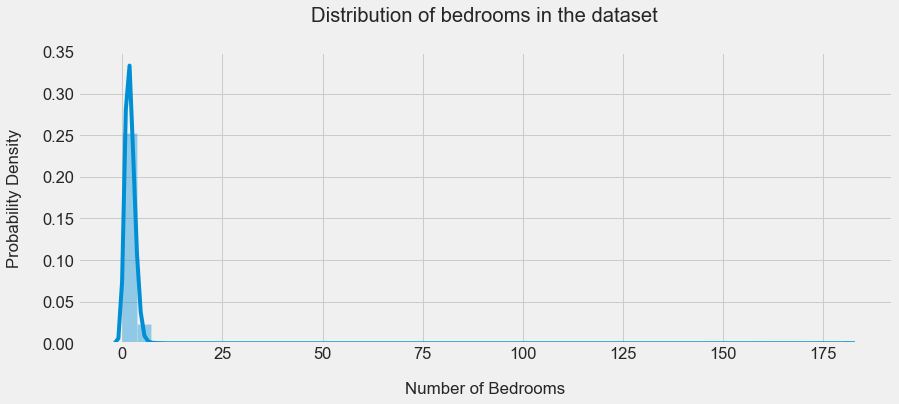

In [ ]:
# Distribution of bedrooms in dataset
plt.figure(figsize=[13,5])

ax = sns.distplot(houses_dummies['bedrooms'], hist=True)

plt.title('Distribution of bedrooms in the dataset', pad=30)
plt.ylabel('Probability Density', labelpad=20)
plt.xlabel('Number of Bedrooms', labelpad=20)
plt.show()

It seems that there are lots of outliers. To handel these outliers, we used `Quantile-based discretization` function. By doing so, we categorized bedrooms into 1, 2, 3, or more bedrooms. Let's see how the new bedrooms look like.

In [ ]:
houses_dummies['bedrooms'] = pd.qcut(houses_dummies['bedrooms'], 4, labels=[1,2,3,4])

In [ ]:
houses_dummies['bedrooms']

title
57 - 270 Timberbank Boulevard          3
24 Marlebon Road                       3
34 Ferris Road                         2
Ph37 - 300 Mill Road                   3
1611 - 31 Tippett Road                 2
                                      ..
1924 - 80 Harrison Garden Boulevard    1
Ph02 - 1331 Queen Street               2
1509 - 7 Michael Power Place           1
410 - 236 Albion Road                  3
1012 - 195 Bonis Avenue                2
Name: bedrooms, Length: 10671, dtype: category
Categories (4, int64): [1 < 2 < 3 < 4]

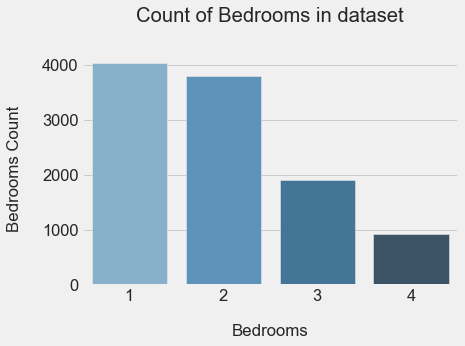

In [ ]:
# Distribution of bedrooms in dataset
sns.countplot(x='bedrooms', data= houses_dummies, palette="Blues_d", dodge=False)

plt.xlabel('Bedrooms', labelpad=20)
plt.ylabel('Bedrooms Count', labelpad=20)
plt.tick_params(axis='x')
plt.tick_params(axis='y')

plt.title('Count of Bedrooms in dataset', pad=30)

plt.show()

Now, let's see how the significance of the features changed.

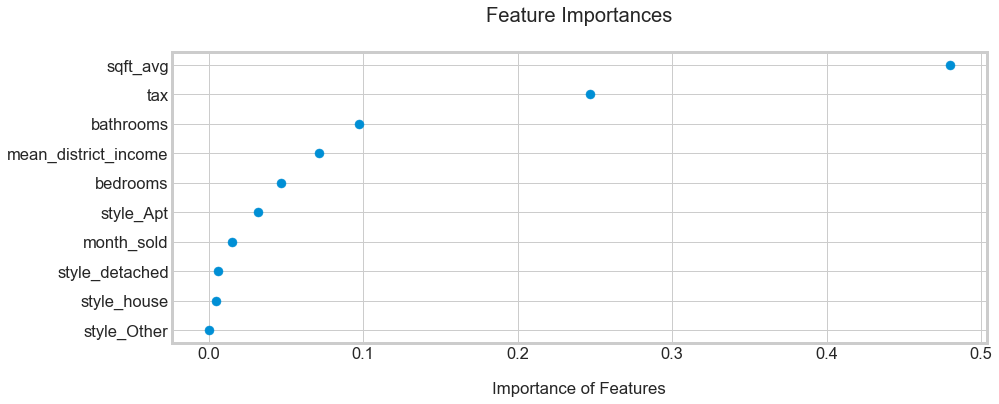

In [ ]:
from sklearn.ensemble import ExtraTreesRegressor

features = houses_dummies.drop('list_price', axis=1)
labels = houses_dummies[['list_price']]

sns.set_style("whitegrid")
plt.figure(figsize=[13,5])
model = ExtraTreesRegressor(n_estimators=10)
model.fit(features, labels)
# display the relative importance of each attribute

sorted_feature_importance = sorted(zip(model.feature_importances_, features.columns))

x = [a[0] for a in sorted_feature_importance]
y = [a[1] for a in sorted_feature_importance]

plt.scatter(x,y)
plt.xlabel('Importance of Features', labelpad=20)
plt.title('Feature Importances', pad=30)
plt.show()

With all of the adjustments made, the importance of features changed significantly. Now, we have the `tax` data as the second most important feature and the `bathrooms` and `bedrooms` as the third and fourth one contributing to the price of the houses.

To better visulaize the features corelations, let's plot the corelation heatmap of the features.

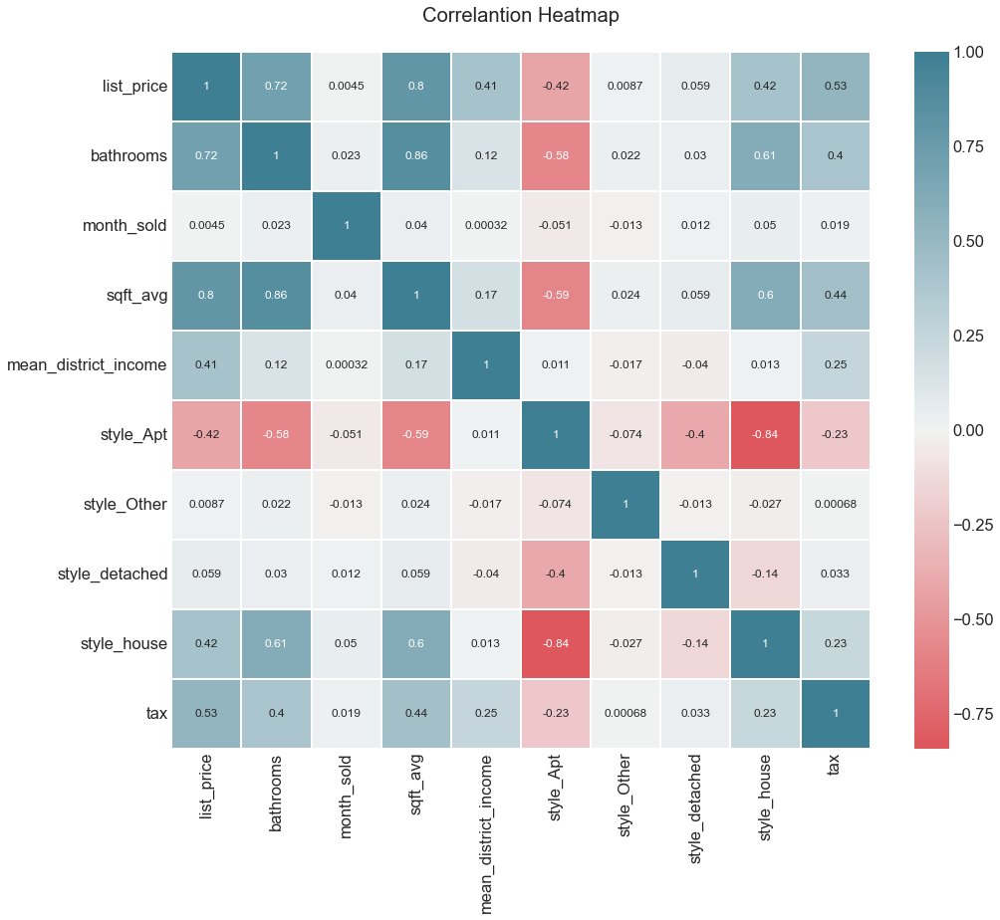

In [ ]:
# Create features Heatmap to see how feature are correlated with final_price
def correlantion_heatmap(df, center = None):
    fig, ax = plt.subplots(figsize = [14,12])
    colormap = sns.diverging_palette(11, 220, as_cmap=True)
    fig = sns.heatmap(df.corr(),
                cmap = colormap,
               center = center,
                annot = True,
                linewidths = 0.1,
                annot_kws={'fontsize':12})
    plt.title('Correlantion Heatmap', pad=30)
    

correlantion_heatmap(houses_dummies, center=0)

As you can see, there is some meaningful co-relation between features. For instance, we can see that the number of `bathrooms` and `sqft` are more co-related to the `style` of apartment. The house price relation with other featrues are also very similar to the calculated importance by the ExtraRegressor in the pervious part.

To have a better understanding of the housing data, let's plot the `sqft` and `style` with Housing price.

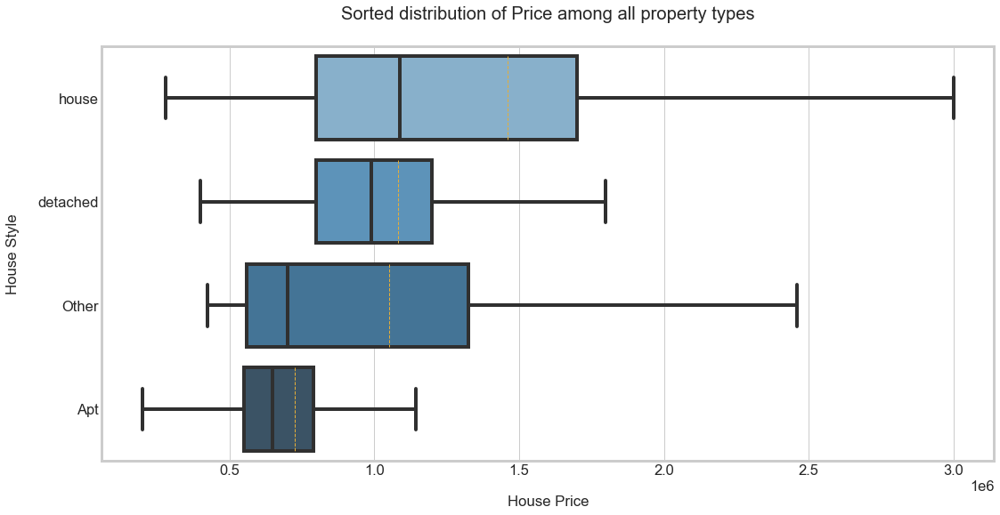

In [ ]:
# sns.set_style("whitegrid")
plt.subplots(figsize=[16,8])

sorted_medians = sorted([(houses_income[houses_income['style']==st].list_price.median(), st) for st in houses_income['style'].unique()], reverse=True)
sns.boxplot(y = 'style', x = 'list_price', data = houses_income, orient='h', showfliers=False, meanline =True, showmeans=True, 
            order=[b for a,b in sorted_medians], palette="Blues_d")

plt.xlabel('House Price', labelpad=20)
plt.ylabel('House Style', labelpad=20)
plt.title('Sorted distribution of Price among all property types', pad=30)
plt.show()

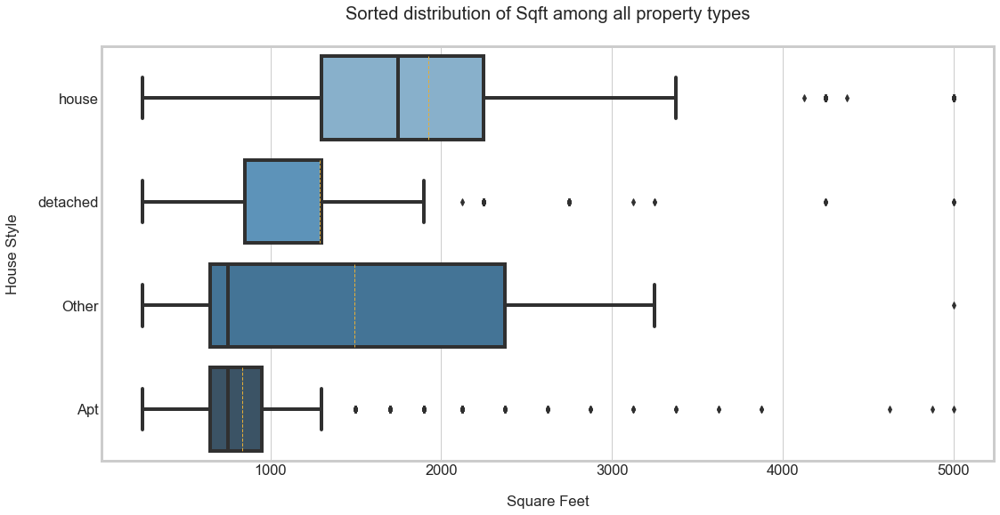

In [ ]:
plt.subplots(figsize=[16,8])

sorted_medians = sorted([(houses_income[houses_income['style']==st].sqft_avg.median(), st) for st in houses_income['style'].unique()], reverse=True)
sns.boxplot(y = 'style', x = 'sqft_avg', data = houses_income, orient='h', showfliers=True, meanline =True, showmeans=True,
           order=[b for a,b in sorted_medians], palette="Blues_d")

plt.xlabel('Square Feet', labelpad=20)
plt.ylabel('House Style', labelpad=20)
plt.title('Sorted distribution of Sqft among all property types', pad=30)
plt.show()

How the house `price`, `style` and `sqft` are related? To understand that, let's plot an scatterplot of both feature.

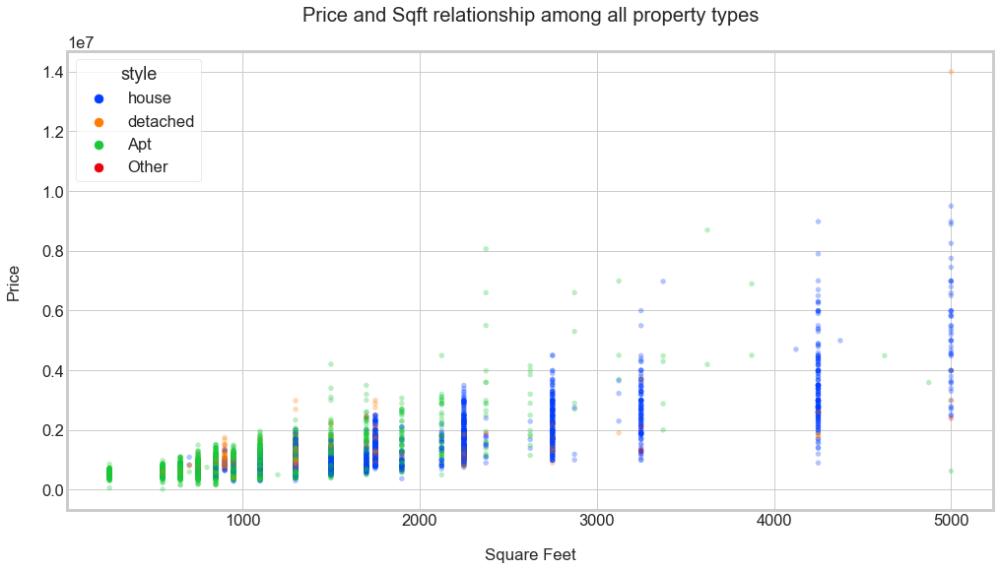

In [ ]:
# Check how final_price and sqft are related to each other among all property types
# sns.set_style("whitegrid")
plt.figure(figsize=[15,8])

ax = sns.scatterplot(x='sqft_avg', y='list_price' ,data=houses_income, hue = houses_income['style'],
                linewidth=0, alpha=0.3, palette='bright', s=30)

plt.xlabel('Square Feet', labelpad=20)
plt.ylabel('Price', labelpad=20)
plt.title('Price and Sqft relationship among all property types', pad=30)
plt.show()

## 6. House Price Prediction

First and foremost is the preprocessing of the data.

In [ ]:
houses_dummies.head()

,list_price,bedrooms,bathrooms,month_sold,sqft_avg,mean_district_income,style_Apt,style_Other,style_detached,style_house,tax
title,,,,,,,,,,,
57 - 270 Timberbank Boulevard,699888,3,3.0,3,1499.5,31826,0,0,0,1,2188.0
24 Marlebon Road,999900,3,2.0,3,1750.0,31771,0,0,1,0,3147.0
34 Ferris Road,1199000,2,2.0,3,900.0,43907,0,0,1,0,4063.0
Ph37 - 300 Mill Road,949000,3,3.0,3,1899.5,62378,0,0,0,1,3080.0
1611 - 31 Tippett Road,899000,2,2.0,3,849.5,51181,1,0,0,0,3076.5


In [ ]:
print(houses_dummies.dtypes)

list_price                 int64
bedrooms                category
bathrooms                float64
month_sold                 int64
sqft_avg                 float64
mean_district_income       int64
style_Apt                  uint8
style_Other                uint8
style_detached             uint8
style_house                uint8
tax                      float64
dtype: object


The data type in our dataset is different than each other. To ease the development of rigorous prediction algorithm, we are going to change all the data types to int64.

In [ ]:
houses_dummies = houses_dummies.astype('int64')
print(houses_dummies.dtypes)

list_price              int64
bedrooms                int64
bathrooms               int64
month_sold              int64
sqft_avg                int64
mean_district_income    int64
style_Apt               int64
style_Other             int64
style_detached          int64
style_house             int64
tax                     int64
dtype: object


### Train, and Test split

To train a prediction model, it is critical to have at least two seperate train and validation dataset. To get that, we are using the sklearn `train_test_split` here.

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(houses_dummies.drop('list_price', axis=1), houses_dummies['list_price'], train_size=0.7)
print(f'Training dataset size:\nX_train: {X_train.shape},\ny_train: {y_train.shape}\n')
print(f'Test dataset size:\nX_test: {X_test.shape},\ny_test: {y_test.shape}')

Training dataset size:
X_train: (7469, 10),
y_train: (7469,)

Test dataset size:
X_test: (3202, 10),
y_test: (3202,)


### Data Normalization

To ease the price prediction, one of the most effective techniques is to normalize the data before model training. Here we are using the `StandardScaler` function of SKlearn to do the data normalization.

In [ ]:
from sklearn import preprocessing

scaler = preprocessing.StandardScaler().fit(X_train)

X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

### Training preliminary models as benchmark

Now that we have all our required elements to build our linear regression models. So, let’s proceed to our next step which is building the preliminary model using scikit-learn.

In this process, we are going to build and train five different types of linear regression models which are:
- OLS model
- Ridge regression model
- Lasso regression model
- Bayesian regression model
- Elastic Net regression model

For all the models, we are going to use the pre-built algorithms provided by the scikit-learn package. And the process for all the models are the same, first, we define a variable to store the model algorithm, next, we fit the train set variables into the model, and finally make some predictions in the test set.

In [ ]:
from sklearn.linear_model import LinearRegression # OLS algorithm
from sklearn.linear_model import Ridge # Ridge algorithm
from sklearn.linear_model import Lasso # Lasso algorithm
from sklearn.linear_model import BayesianRidge # Bayesian algorithm
from sklearn.linear_model import ElasticNet # ElasticNet algorithm

from sklearn.metrics import mean_squared_error # evaluation of errors
from sklearn.metrics import explained_variance_score as evs # evaluation metric
from sklearn.metrics import r2_score as r2 # evaluation metric

In [ ]:
# OLS
ols = LinearRegression()
ols.fit(X_train_scaled, y_train)
ols_yhat = ols.predict(X_test_scaled)
ols_test_error = mean_squared_error(y_test, ols_yhat)
print('OLS test RMSE: ${}'.format(ols_test_error))

# Ridge
ridge = Ridge(alpha = 0.5)
ridge.fit(X_train_scaled, y_train)
ridge_yhat = ridge.predict(X_test_scaled)
ridge_test_error = mean_squared_error(y_test, ridge_yhat)
print('Ridge test RMSE: ${}'.format(ridge_test_error))

# Lasso
lasso = Lasso(alpha = 0.01)
lasso.fit(X_train_scaled, y_train)
lasso_yhat = lasso.predict(X_test_scaled)
lasso_test_error = mean_squared_error(y_test, lasso_yhat)
print('Lasso test RMSE: ${}'.format(lasso_test_error))

# Bayesian
bayesian = BayesianRidge()
bayesian.fit(X_train_scaled, y_train)
bayesian_yhat = bayesian.predict(X_test_scaled)
bayesian_test_error = mean_squared_error(y_test, bayesian_yhat)
print('Bayesian test RMSE: ${}'.format(bayesian_test_error))

# ElasticNet
en = ElasticNet(alpha = 0.01)
en.fit(X_train_scaled, y_train)
en_yhat = en.predict(X_test_scaled)
en_test_error = mean_squared_error(y_test, en_yhat)
print('ElasticNet test RMSE: ${}'.format(en_test_error))


OLS test RMSE: $106291662501.89075
Ridge test RMSE: $106284797062.59268
Lasso test RMSE: $106291661624.5652
Bayesian test RMSE: $106241232344.69398
ElasticNet test RMSE: $105814840742.8077


Using the algorithms provided by scikit-learn, we have successfully built five different linear regression models. Now, to know which model is more appropriate for our data, we can evaluate each of the models using the evaluation metrics and come to a conclusion.

### Evaluation of benchmark models 

To evaluate our preliminary models we are going to use the ‘explained_variance_score’ metric and the ‘r2_score’ metric functions which are provided by the scikit-learn package in python.

When it comes to the ‘explained_variance_score’ metric, the score should not below 0.60 or 60%. If it is the case, then our built model is not sufficient for our data to solve the given case. So, the ideal score of the ‘explained_variance_score’ should be between 0.60 and 1.0.

We are now going to compare the metric scores of each model and choose which model is more suitable for the given dataset. Let’s start with the ‘explained_variance_score’ evaluation metric in python.

In [ ]:
# estimate the explained variance score

print('EXPLAINED VARIANCE SCORE:')
print('-------------------------------------------------------------------------------')
print('Explained Variance Score of OLS model is {}'.format(evs(y_test, ols_yhat)))
print('-------------------------------------------------------------------------------')
print('Explained Variance Score of Ridge model is {}'.format(evs(y_test, ridge_yhat)))
print('-------------------------------------------------------------------------------')
print('Explained Variance Score of Lasso model is {}'.format(evs(y_test, lasso_yhat)))
print('-------------------------------------------------------------------------------')
print('Explained Variance Score of Bayesian model is {}'.format(evs(y_test, bayesian_yhat)))
print('-------------------------------------------------------------------------------')
print('Explained Variance Score of ElasticNet is {}'.format(evs(y_test, en_yhat)))
print('-------------------------------------------------------------------------------')

EXPLAINED VARIANCE SCORE:
-------------------------------------------------------------------------------
Explained Variance Score of OLS model is 0.7555118976060717
-------------------------------------------------------------------------------
Explained Variance Score of Ridge model is 0.7555276969476976
-------------------------------------------------------------------------------
Explained Variance Score of Lasso model is 0.7555118996233746
-------------------------------------------------------------------------------
Explained Variance Score of Bayesian model is 0.7556279519468636
-------------------------------------------------------------------------------
Explained Variance Score of ElasticNet is 0.7566092131793722
-------------------------------------------------------------------------------


We can see that, every model while rounding the output values will result in a score of 0.73 (73%) which means our model performs well on our dataset and can be used to solve real-world problems. Coming to the case of choosing the best model, the `Bayesian` regression model takes the place of being more accurate while comparing the other models (on the basis of Explained Variance Score). It is followed by the `ElasticNet` regression model. The worst performer among the models is the `OLS` regression model.

Our next evaluation metric is the ‘r2_score’ (R-squared) metric. R-squared is a measurement of how well the dependent variable explains the variance of the independent variable. It is the most popular evaluation metric for regression models. The ideal ‘r2_score’ of a build should be more than 0.70 (at least > 0.60).

In [ ]:
# estimate r-squared values
print('R-SQUARED:')
print('-------------------------------------------------------------------------------')
print('R-Squared of OLS model is {}'.format(r2(y_test, ols_yhat)))
print('-------------------------------------------------------------------------------')
print('R-Squared of Ridge model is {}'.format(r2(y_test, ridge_yhat)))
print('-------------------------------------------------------------------------------')
print('R-Squared of Lasso model is {}'.format(r2(y_test, lasso_yhat)))
print('-------------------------------------------------------------------------------')
print('R-Squared of Bayesian model is {}'.format(r2(y_test, bayesian_yhat)))
print('-------------------------------------------------------------------------------')
print('R-Squared of ElasticNet is {}'.format(r2(y_test, en_yhat)))
print('-------------------------------------------------------------------------------')

R-SQUARED:
-------------------------------------------------------------------------------
R-Squared of OLS model is 0.7554469457871403
-------------------------------------------------------------------------------
R-Squared of Ridge model is 0.7554627416088382
-------------------------------------------------------------------------------
R-Squared of Lasso model is 0.7554469478056678
-------------------------------------------------------------------------------
R-Squared of Bayesian model is 0.7555629741629942
-------------------------------------------------------------------------------
R-Squared of ElasticNet is 0.7565440047168267
-------------------------------------------------------------------------------


When analyzing the report, it is noted that the R-squared of the `Bayesian` regression model is seemed to be the highest which means, it takes the place of being the most suitable model for our dataset (on the basis of R-squared). It is followed by the `Elastic Net` regression model. The worst performer among the models is again the `OLS` regression model.

We can conclude that `Bayesian` regression models is the best model to be used for our house price dataset.

Another way of understanding the performance (and appropriateness) of a model is through a residual plot. Let's plot `Bayesian` residual plot.

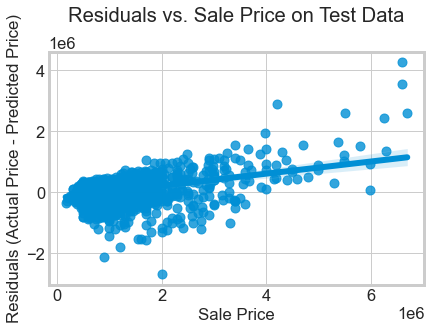

In [ ]:
residuals = y_test - bayesian_yhat
ax = sns.regplot(y_test, residuals)
ax.set_xlabel('Sale Price')
ax.set_ylabel('Residuals (Actual Price - Predicted Price)')
ax.set_title("Residuals vs. Sale Price on Test Data", pad= 30);

### Performant model training
The benchmarking models did not achieved the satisfactory performance. Therefore, another exhustive round of search for performant algorithm is conducted. In this round, all of the selected algorithms are trained and evaluated.

In [ ]:
from sklearn.metrics import mean_squared_error

from sklearn.ensemble import AdaBoostRegressor, BaggingRegressor, ExtraTreesRegressor, GradientBoostingRegressor, RandomForestRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn.linear_model import LinearRegression, LassoCV, RidgeCV, ElasticNetCV, ARDRegression, BayesianRidge, HuberRegressor, LarsCV, OrthogonalMatchingPursuitCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import NuSVR, SVR
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import ShuffleSplit, cross_validate, GridSearchCV, KFold
from sklearn.isotonic import  IsotonicRegression
from sklearn.cross_decomposition import PLSRegression
from sklearn.preprocessing import RobustScaler
from sklearn.pipeline import make_pipeline
from sklearn.metrics import make_scorer
import lightgbm as lgb
import xgboost as xgb


#Machine Learning Algorithm (MLA) Selection and Initialization
MLA = [
    #Ensemble Methods
    AdaBoostRegressor(),
    BaggingRegressor(),
    ExtraTreesRegressor(),
    GradientBoostingRegressor(),
    RandomForestRegressor(),
    lgb.LGBMRegressor(),
    xgb.XGBRegressor(objective='reg:squarederror'),
        
    #GLM
    LinearRegression(),
    make_pipeline(RobustScaler(), LassoCV()),
    make_pipeline(RobustScaler(), ElasticNetCV()),
    RidgeCV(),
    LarsCV(),
    BayesianRidge(),
    HuberRegressor(),
    OrthogonalMatchingPursuitCV(),
    
   #Decomposition
    PLSRegression(),
    
    #KNN
    KNeighborsRegressor(),
    
    #SVM
    NuSVR(),
    SVR(),
    
    #Tree Models
    DecisionTreeRegressor()   
    ]

#create table to compare MLA metrics
MLA_columns = ['ML Name', 'ML Parameters', 'Train Loss Mean', 'Test Loss Mean', 'Test R2', 'ML Time']
MLA_compare = pd.DataFrame(columns = MLA_columns)

#index through MLA and save performance to table
row_index = 0
for alg in MLA:

    #set name and parameters
    MLA_name = alg.__class__.__name__
    print(MLA_name + '_'*10, end="\r")
    MLA_compare.loc[row_index, 'ML Name'] = MLA_name
    MLA_compare.loc[row_index, 'ML Parameters'] = str(alg.get_params())
    
    #score model with cross validation
    cv_results = cross_validate(alg, X_train_scaled, y_train, cv=5,
                        scoring=('r2', 'neg_mean_squared_error'),
                        return_train_score=True)
    
    MLA_compare.loc[row_index, 'ML Time'] = cv_results['fit_time'].mean()
    MLA_compare.loc[row_index, 'Train Loss Mean'] = -cv_results['train_neg_mean_squared_error'].mean()
    MLA_compare.loc[row_index, 'Test Loss Mean'] = -cv_results['test_neg_mean_squared_error'].mean()
    MLA_compare.loc[row_index, 'Test R2'] = cv_results['test_r2'].mean()
    
    row_index+=1
    
    
MLA_compare.sort_values('Test Loss Mean', inplace = True, ascending = True)
MLA_compare

,ML Name,ML Parameters,Train Loss Mean,Test Loss Mean,Test R2,ML Time
5,LGBMRegressor,"{'boosting_type': 'gbdt', 'class_weight': None...",29117656695.514576,57496978725.621071,0.891654,0.087663
2,ExtraTreesRegressor,"{'bootstrap': False, 'ccp_alpha': 0.0, 'criter...",25614111.068423,63027603758.895828,0.883723,0.924918
3,GradientBoostingRegressor,"{'alpha': 0.9, 'ccp_alpha': 0.0, 'criterion': ...",25447637062.519703,70196484452.235336,0.868271,0.310957
6,XGBRegressor,"{'objective': 'reg:squarederror', 'base_score'...",4639007985.778696,77740561947.195114,0.855194,0.241355
4,RandomForestRegressor,"{'bootstrap': True, 'ccp_alpha': 0.0, 'criteri...",9764665955.523478,80264341401.589142,0.84437,1.261648
16,KNeighborsRegressor,"{'algorithm': 'auto', 'leaf_size': 30, 'metric...",52945595137.204277,83550096759.837601,0.845477,0.016155
1,BaggingRegressor,"{'base_estimator': None, 'bootstrap': True, 'b...",11559447341.838236,88036966018.887238,0.829642,0.14978
0,AdaBoostRegressor,"{'base_estimator': None, 'learning_rate': 1.0,...",74183304378.74646,109779016272.789505,0.797213,0.137417
19,DecisionTreeRegressor,"{'ccp_alpha': 0.0, 'criterion': 'mse', 'max_de...",25588700.916768,133508896090.226959,0.738586,0.018948
15,PLSRegression,"{'copy': True, 'max_iter': 500, 'n_components'...",142458723012.193176,463403429713.658081,0.125484,0.003191


To better visualize the performance of different models, the `Testing loss` of each algorithms are ploted as barplots.

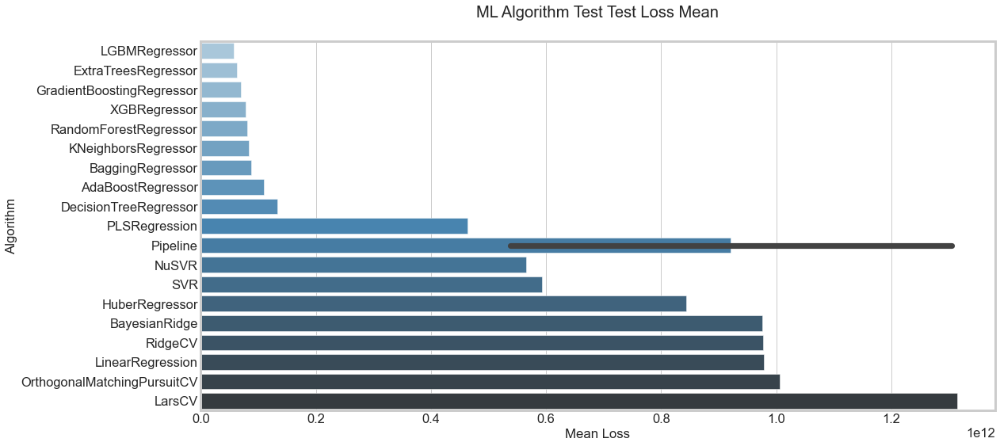

In [ ]:
fig, ax = plt.subplots(figsize = [16,8])

sns.barplot(x = 'Test Loss Mean', y = 'ML Name', data = MLA_compare, palette= ("Blues_d"))

plt.title('ML Algorithm Test Test Loss Mean', pad=30)
plt.xlabel('Mean Loss')
plt.ylabel('Algorithm')
plt.show()

Based on the above figure, LGBMRegressor are among the most high performing algorithm. Therefore, it is chosen for hyperparameter tunning.

Since the three hyperparameter of `num_leaves`, `max_depth`, and `learning_rate` are recognized as most essential factors, a grid search is designed on these parameters.

In [ ]:
#Grid Search
from sklearn.model_selection import GridSearchCV
# instatiate a  model
model = lgb.LGBMRegressor()

# establish dict of hyperparameters
grid_values = {
    'num_leaves': [50, 100, 150],
    'max_depth' : [-1, 5, 10],
    'learning_rate': [0.01, 0.1, 0.3]
}

# set gridsearch
grid_model_acc = GridSearchCV(model, param_grid = grid_values, scoring = 'r2' , cv = 5)

# fit data
grid_model_acc.fit(X_train_scaled, y_train)

#Predict values based on new parameters
y_pred_acc = grid_model_acc.predict(X_test_scaled)

# New Model Evaluation metrics 
print('R2 Score : ' + str(r2(y_test, y_pred_acc)))
print(grid_model_acc.best_params_)

R2 Score : 0.8869062808143994
{'learning_rate': 0.1, 'max_depth': -1, 'num_leaves': 100}


Our model is able to acheive an `R2 Score` of %91, after hyperparameter tunning.

## 7. Conclusion

This project was designed and implemented to fulfill the project 2 of the CIV1498 at Unversity of Toronto.

### Summary

In this project, we raised some unanswered questions about the housing price in the city of Toronto. In order to investigate the problem statement and find explanations for the questions raised, we collected data from one of the most renowned online realtor websites, Zolo.com. By using their website, we were able to extract useful data about the houses sold during the last year. The collected dataset from this website includes comprehensive information on the houses sold during the last year. However, the housing price is not only about the house itself and its physical attributes. In order to include neighbourhood data in our analysis, we used the open data portal of the city of Toronto. 

By merging the city neighbourhood profile and selling houses in Toronto, we created a very rich dataset. This dataset paves a decent foundation for Exploratory Data Analysis (EDA). We used this data to extract the relations between houses' features and their prices. Using the EDA techniques, we extracted meaningful relationships between our data and visualized these relationships using interactive libraries, such as Bokeh and Seaborn.

Conducted EDA helped us to identify the most relevant features playing role in the housing price. Using this information, we aimed to train a prediction model that can estimate the house price based on not only the physical attributes of the house but also the neighbourhood data. To train this model, we pre-processed our data and split them into two datasets of training and test data. We used the training data to fit more than 20 machine learning algorithms and estimated their performance on our test data. Our analysis indicated that the LGBMRegressor is the most suitable model for our problem and dataset. So, in the last stage, we conducted a hyperparameter tunning on the LGBMRegressor. By tunning the optimal hyperparameter, our model was able to achieve %91 of the R2 score in its predictions.

### Challenges and Limitations

1. One of the most challenging tasks in this analysis was to create a suitable dataset of houses sold during the past years. There exist numerous powerful realtor websites online which collected the sold houses data during the past years. However, all of these websites elude from sharing the data with the public. Limited access to the public dataset, creates a significant hindrance to conducting accurate and robust analyses of the housing prices. To overcome this challenge, our team used all of the HTML data of one of these online realtors. We were able to retrieve most of the housing data by conducting an intensive search among the metadata of the website's HTML code. We are completely aware that having access to the public dataset of houses sold might impose ethical issues such as privacy concerns; however, the benefits of having riched data seem to outweigh the downsides. By having access to the suitable data not only the government will have a powerful tool to analyze the housing price escalation in Toronto, but also the public awareness would be raised by bringing openness to the problem.
2. Another limitation of our analysis is the age of the available public data. We used some of the publicly available data on the open portal of the city of Toronto, which were collected more than 4 years ago. Some of the data might be changed during the past years, and, inevitably, affect our analysis accuracy.

### Future Research Potential

During our analysis, we find some interesting yet surprising points that can be worthwhile for further studies.
1. One of the noteworthy research potentials is to investigate how the Covid19 and the recent pandemic affected the house pricing in Toronto. By investigating the house prices, we can see an uptrend in the prices simultaneous with an increase in the demand side. This phenomenon is a rare event and experts are finding the pandemic and lockdowns one of the most contributing factors.
2. In this project, we included the average income of each neighbourhood as the only input from the neighbourhood profile of the city. We believe that the analysis would be more accurate if more information on the neighbourhood profile are included in the analysis. Information such as the average age of the neighbourhood, and proximity to the high-quality schools and universities can play an important role in the land and house values.